In [24]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

[master f54be170] From Mac
 1 file changed, 199 insertions(+), 2 deletions(-)
Counting objects: 5, done.
Delta compression using up to 4 threads.
Compressing objects: 100% (5/5), done.
Writing objects: 100% (5/5), 1.87 MiB | 1.15 MiB/s, done.
Total 5 (delta 4), reused 0 (delta 0)
remote: Resolving deltas: 100% (4/4), completed with 4 local objects.
To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   ff108a83..f54be170  master -> master


In [2]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [3]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


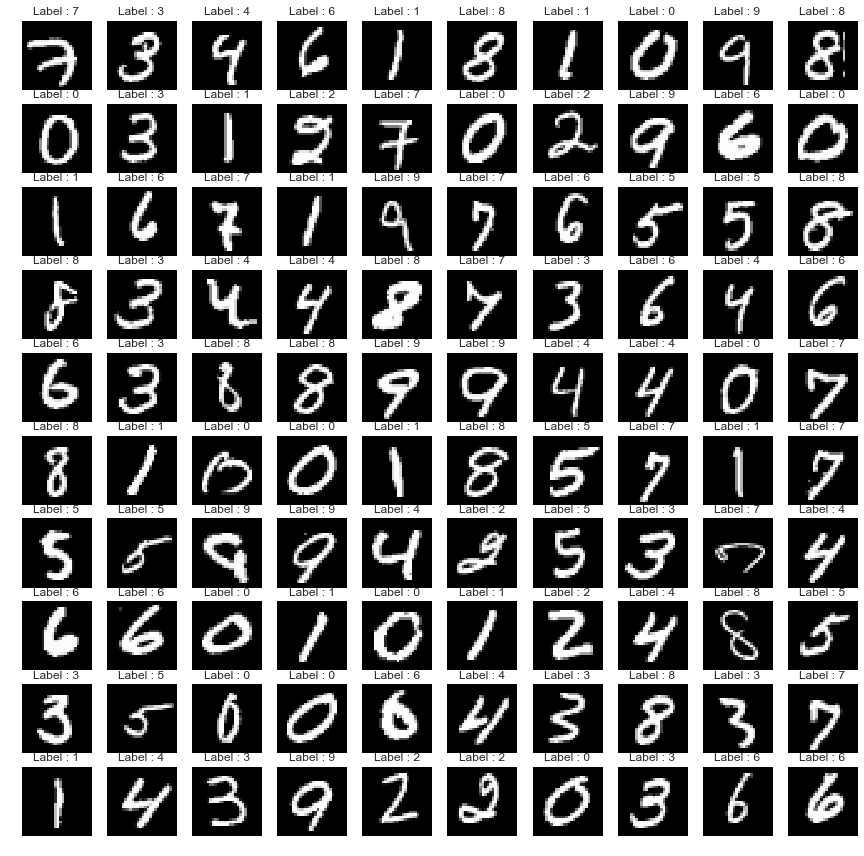

In [4]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [15]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [16]:
# hyper class
num_epoch = 101; batch_size = 100; print_size = 1; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

aimed_range = tf.placeholder(shape=[],dtype=tf.float32)

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

# 0.00005
def norm_vec(x,aimed_range):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (aimed_range + aimed_range) - aimed_range

In [17]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_,aimed_range)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3,aimed_range)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2,aimed_range)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1,aimed_range)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3,aimed_range)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2,aimed_range)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [18]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [19]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [20]:
# 3. update the generator 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(norm_vec(fake_disgrad1,aimed_range)+fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(norm_vec(fake_egrad3,aimed_range)+fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(norm_vec(fake_egrad2,aimed_range)+fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

 iter: 0 batch: 19900 range: 8e-05 recon cost: 0.2275502 zero cost: 0.001477366								 one  cost: 0.02337788 fake cost: 12.2033141264835

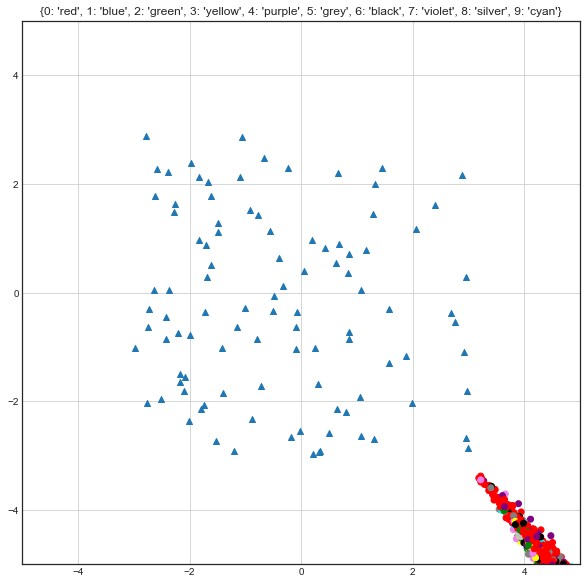

 iter: 1 batch: 19900 range: 7.2e-05 recon cost: 0.22145145 zero cost: 0.22688027								 one  cost: 0.42554212 fake cost: 3.24602415765

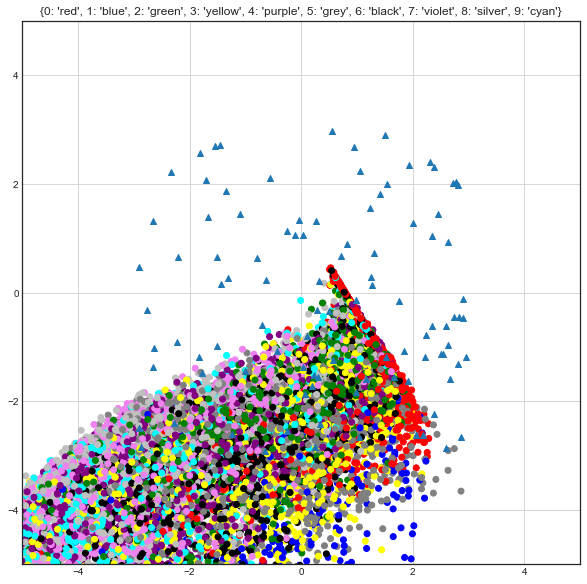

 iter: 2 batch: 19900 range: 6.48e-05 recon cost: 0.19922316 zero cost: 0.34845674								 one  cost: 0.46246243 fake cost: 2.3725114

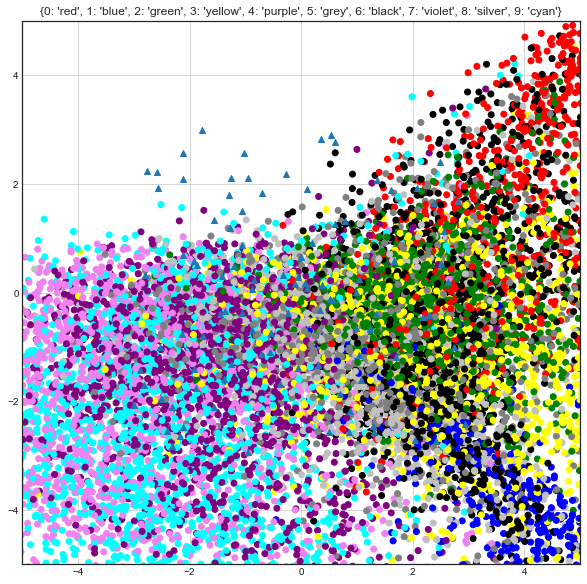

 iter: 3 batch: 19900 range: 5.8320000000000004e-05 recon cost: 0.19151923 zero cost: 0.4821294								 one  cost: 0.5032978 fake cost: 1.615850166

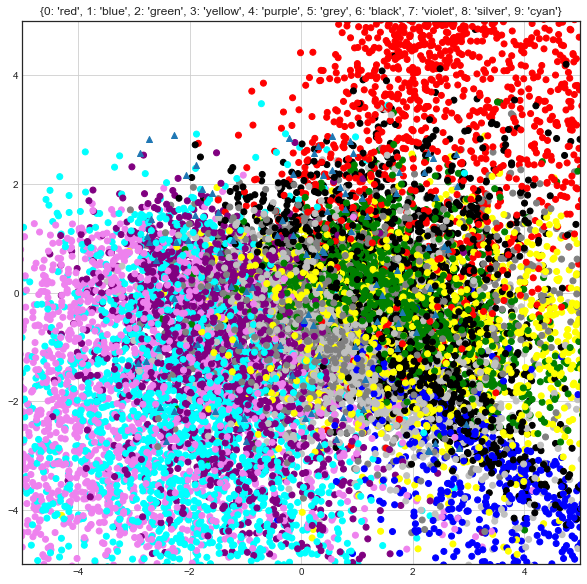

 iter: 4 batch: 19900 range: 5.2488e-05 recon cost: 0.18701383 zero cost: 0.4778124								 one  cost: 0.5092589 fake cost: 1.833139356

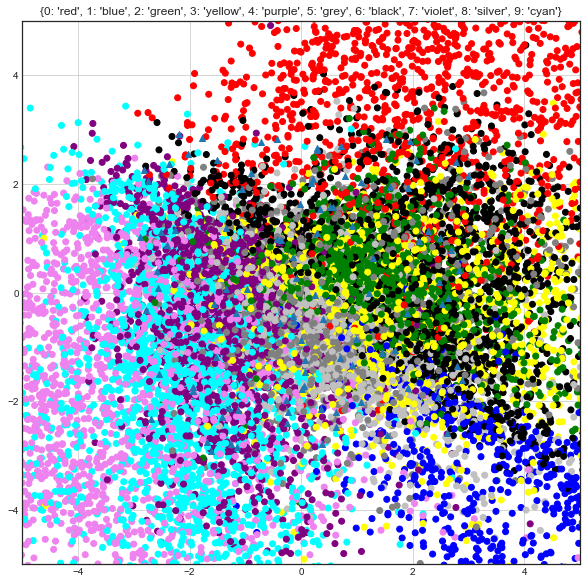

 iter: 5 batch: 19900 range: 4.723920000000001e-05 recon cost: 0.18468845 zero cost: 0.49415952								 one  cost: 0.48645714 fake cost: 2.0106637

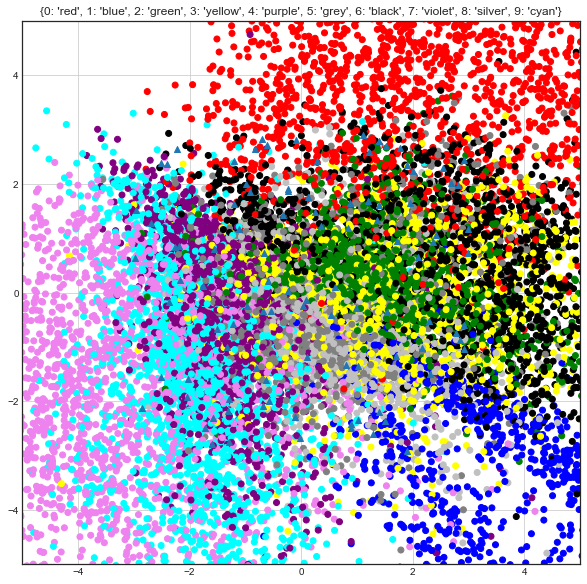

 iter: 6 batch: 19900 range: 4.251528000000001e-05 recon cost: 0.18289302 zero cost: 0.51622045								 one  cost: 0.49686408 fake cost: 2.12654424

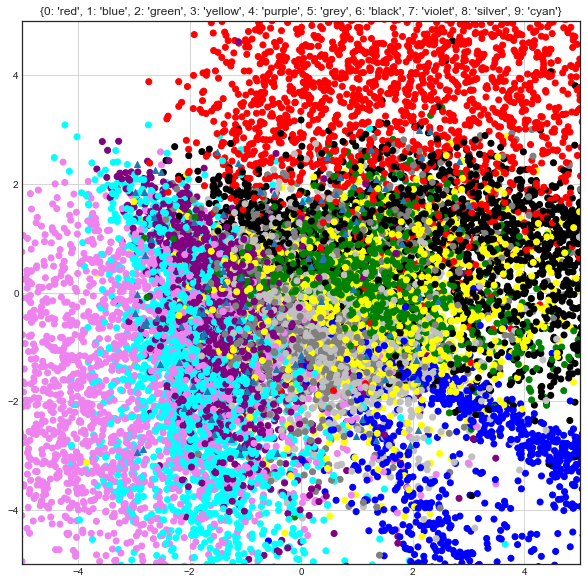

 iter: 7 batch: 19900 range: 3.8263752000000007e-05 recon cost: 0.18152624 zero cost: 0.5521333								 one  cost: 0.50338775 fake cost: 1.96862461

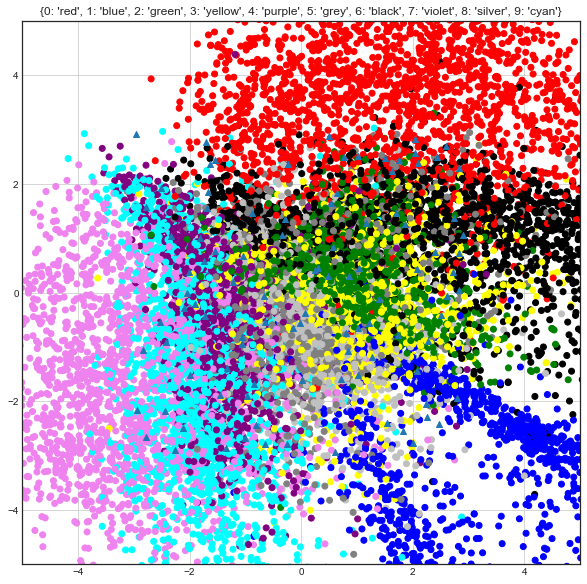

 iter: 8 batch: 19900 range: 3.4437376800000004e-05 recon cost: 0.18041418 zero cost: 0.61249655								 one  cost: 0.47592527 fake cost: 1.8720415

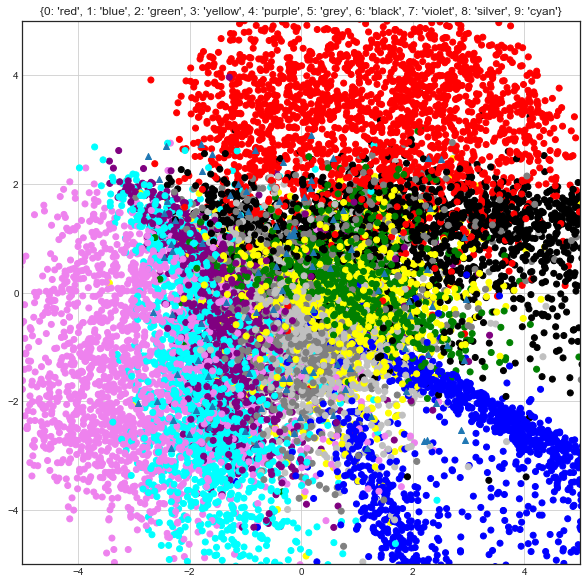

 iter: 9 batch: 19900 range: 3.0993639120000006e-05 recon cost: 0.17949843 zero cost: 0.6216965								 one  cost: 0.4976567 fake cost: 1.781747766

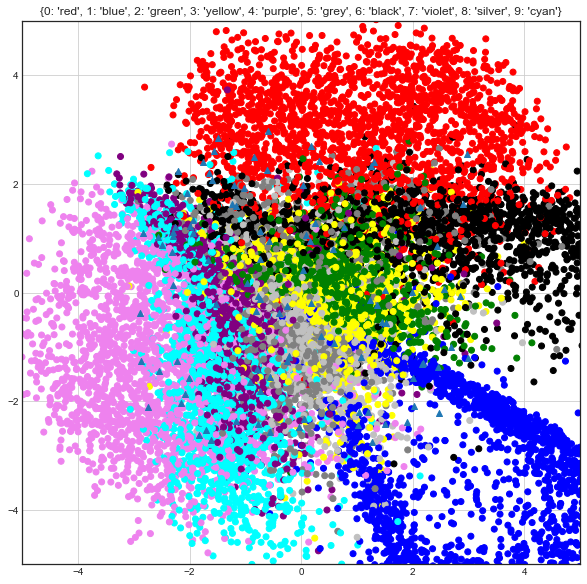

 iter: 10 batch: 19900 range: 2.7894275208000006e-05 recon cost: 0.17868869 zero cost: 0.6096116								 one  cost: 0.4596731 fake cost: 1.707417742

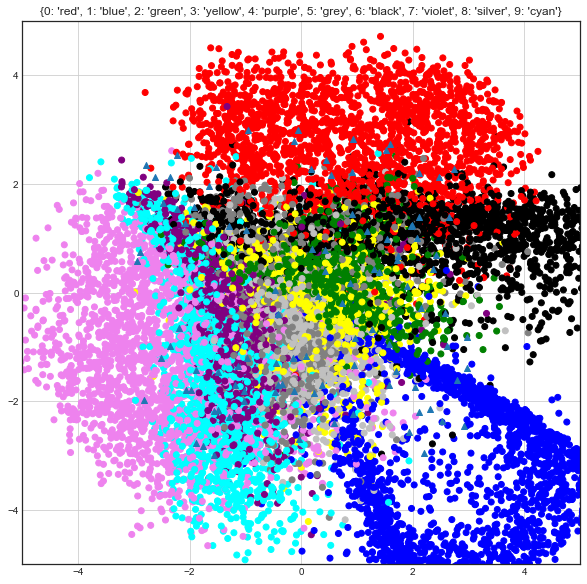

 iter: 11 batch: 19900 range: 2.5104847687200004e-05 recon cost: 0.1781168 zero cost: 0.601383								 one  cost: 0.4939597 fake cost: 1.59850680081

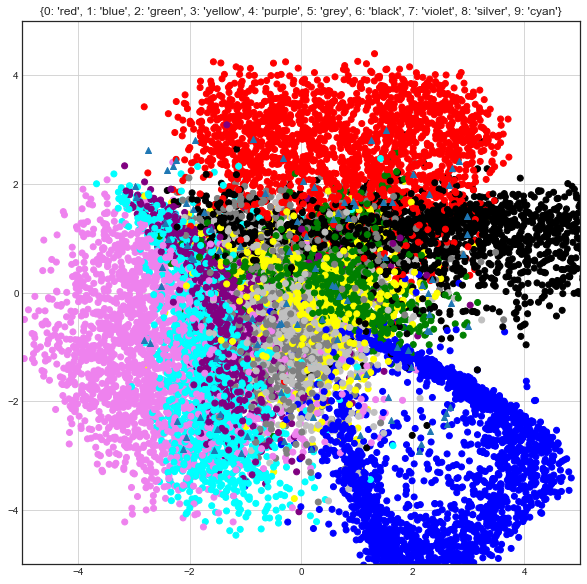

 iter: 12 batch: 19900 range: 2.2594362918480005e-05 recon cost: 0.17731912 zero cost: 0.6016038								 one  cost: 0.5146479 fake cost: 1.582423684

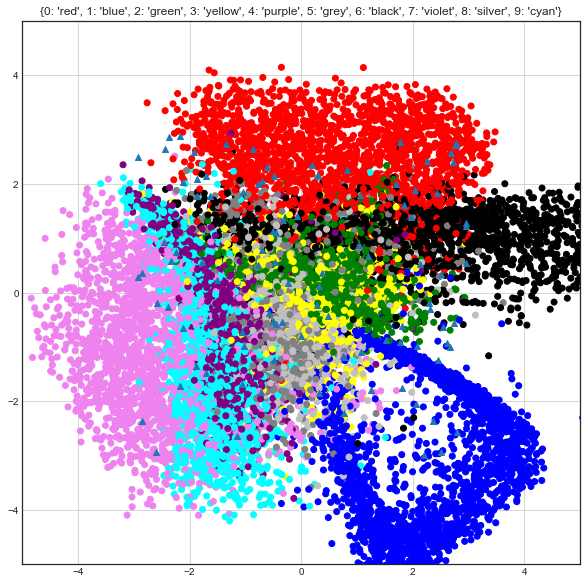

 iter: 13 batch: 19900 range: 2.0334926626632005e-05 recon cost: 0.17672749 zero cost: 0.57849604								 one  cost: 0.50900084 fake cost: 1.5319769

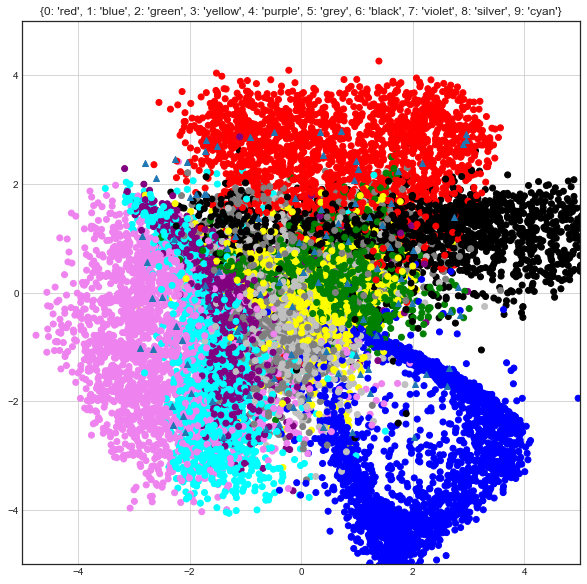

 iter: 14 batch: 19900 range: 1.8301433963968804e-05 recon cost: 0.1758108 zero cost: 0.57592225								 one  cost: 0.5258073 fake cost: 1.551467254

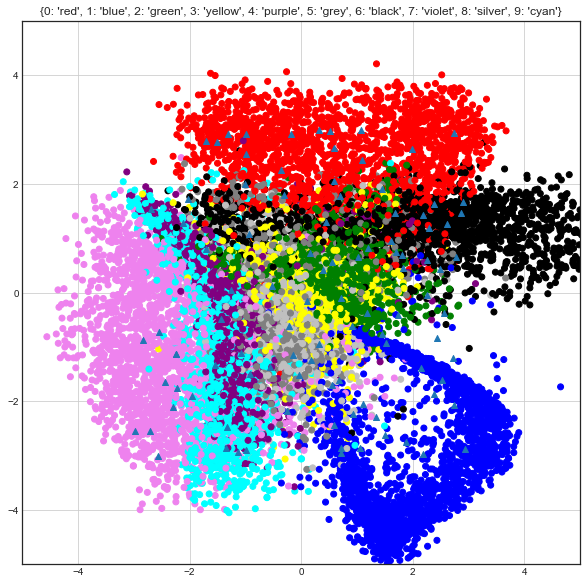

 iter: 15 batch: 19900 range: 1.6471290567571925e-05 recon cost: 0.17519267 zero cost: 0.5467037								 one  cost: 0.5092675 fake cost: 1.457828268

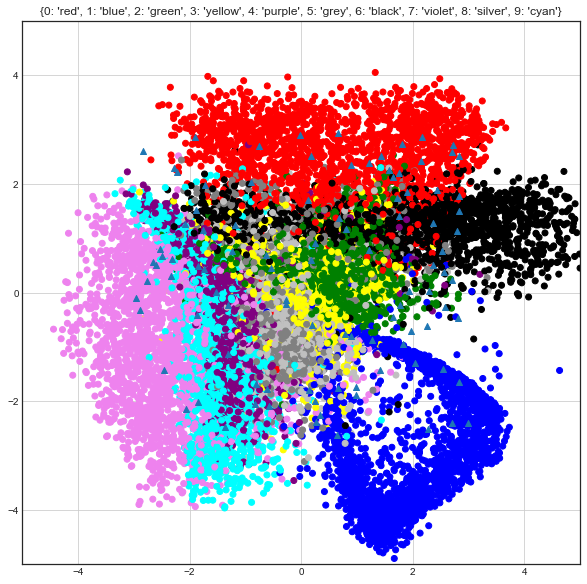

 iter: 16 batch: 19900 range: 1.4824161510814733e-05 recon cost: 0.1749041 zero cost: 0.5445379								 one  cost: 0.550187 fake cost: 1.40699231374

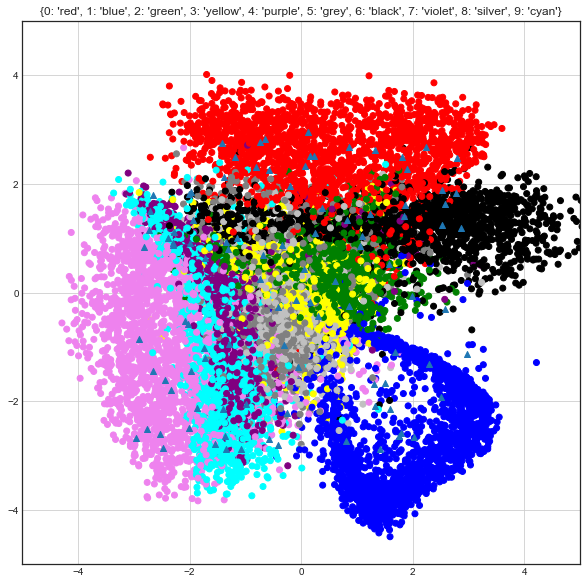

 iter: 17 batch: 19900 range: 1.3341745359733259e-05 recon cost: 0.17428578 zero cost: 0.5462368								 one  cost: 0.49445423 fake cost: 1.41450466

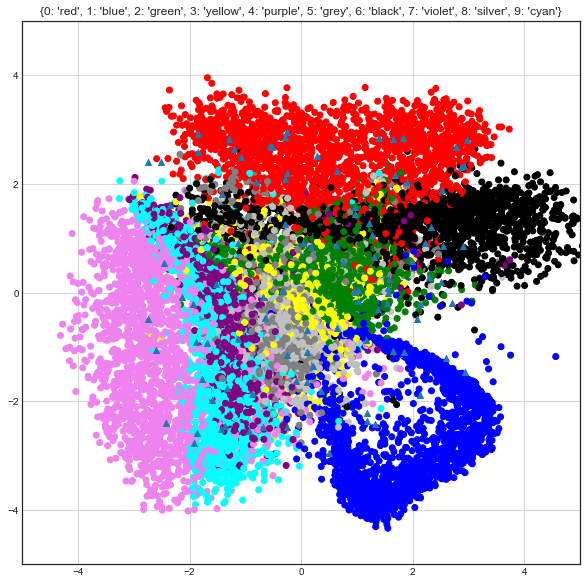

 iter: 18 batch: 19900 range: 1.2007570823759934e-05 recon cost: 0.17383529 zero cost: 0.5557203								 one  cost: 0.55168074 fake cost: 1.323335434

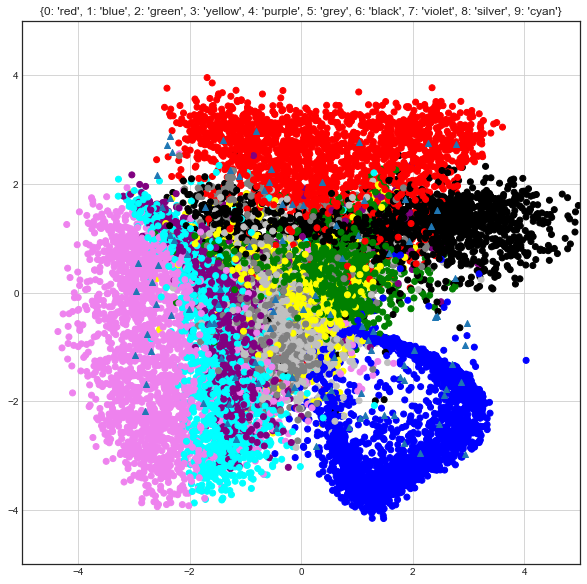

 iter: 19 batch: 19900 range: 1.080681374138394e-05 recon cost: 0.17337115 zero cost: 0.5384754								 one  cost: 0.5483666 fake cost: 1.3937628196

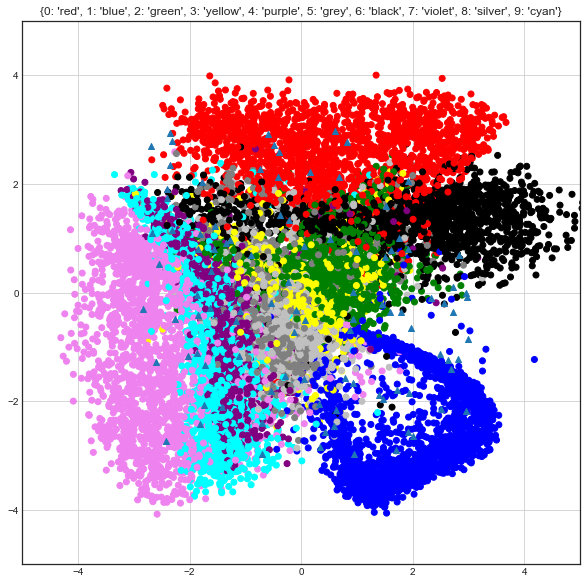

 iter: 20 batch: 19900 range: 9.726132367245547e-06 recon cost: 0.17243935 zero cost: 0.5567137								 one  cost: 0.5602145 fake cost: 1.2706928533

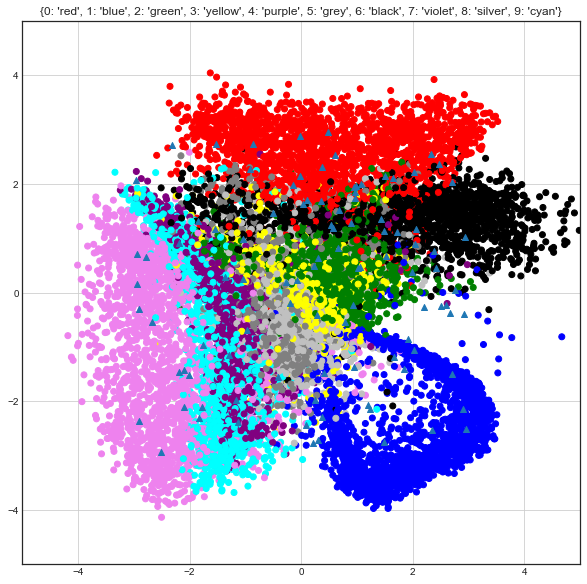

 iter: 21 batch: 19900 range: 8.753519130520993e-06 recon cost: 0.17208193 zero cost: 0.5559573								 one  cost: 0.5707131 fake cost: 1.173416954

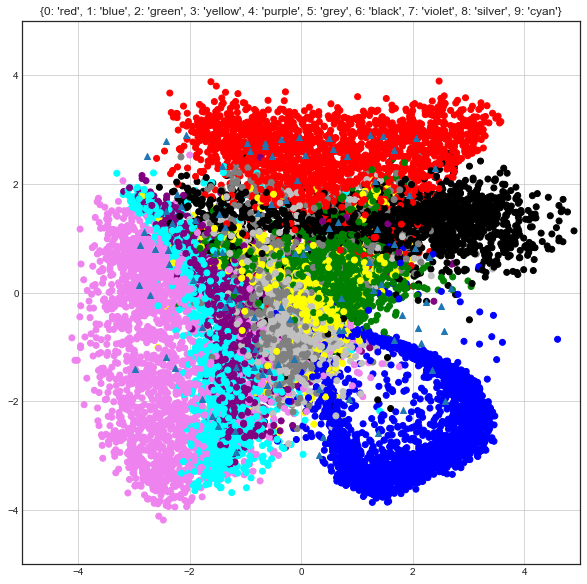

 iter: 22 batch: 19900 range: 7.878167217468894e-06 recon cost: 0.1715058 zero cost: 0.56143194								 one  cost: 0.5822159 fake cost: 1.1289006194

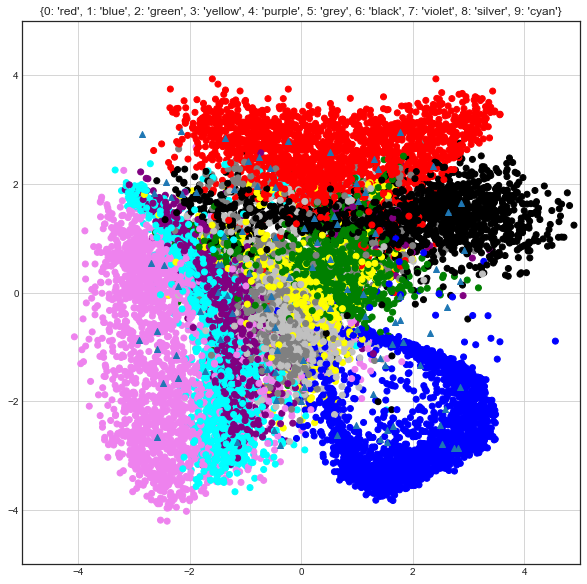

 iter: 23 batch: 19900 range: 7.0903504957220045e-06 recon cost: 0.17106389 zero cost: 0.58480716								 one  cost: 0.546003 fake cost: 1.0898124975

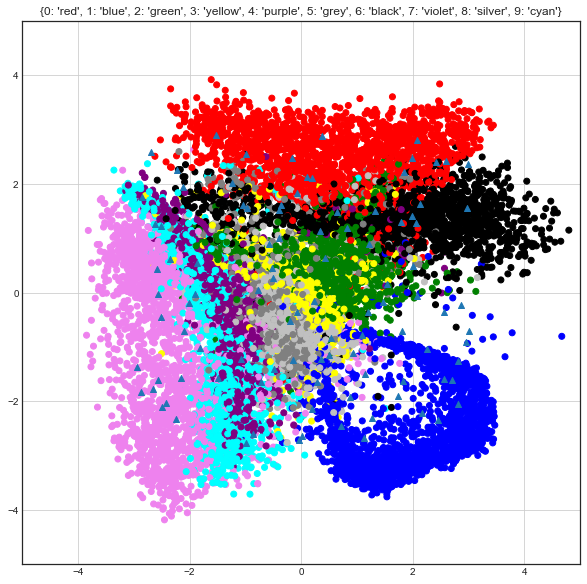

 iter: 24 batch: 19900 range: 6.381315446149804e-06 recon cost: 0.17006129 zero cost: 0.56844455								 one  cost: 0.48843974 fake cost: 1.1735512

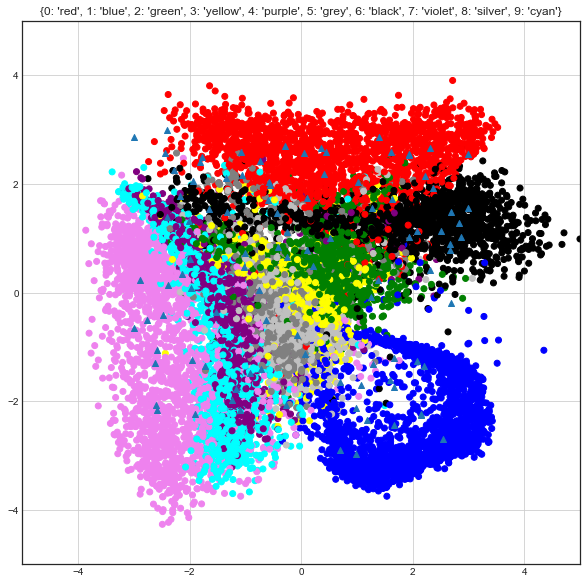

 iter: 25 batch: 19900 range: 5.743183901534824e-06 recon cost: 0.17011377 zero cost: 0.5885925								 one  cost: 0.6084122 fake cost: 1.0898104457

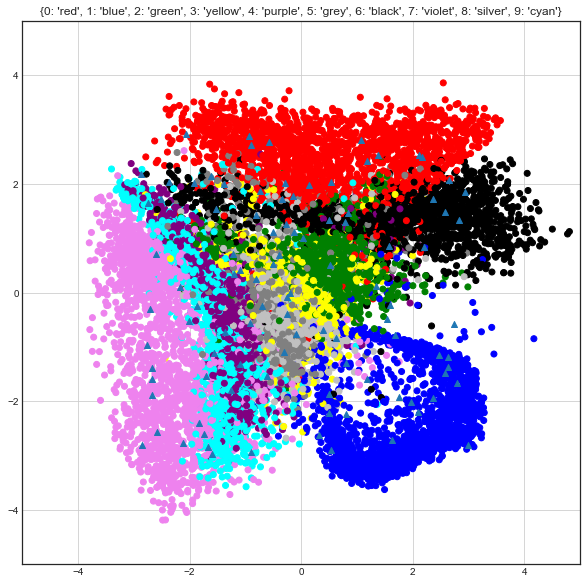

 iter: 26 batch: 19900 range: 5.1688655113813415e-06 recon cost: 0.16906962 zero cost: 0.54773253								 one  cost: 0.57132614 fake cost: 1.2056301

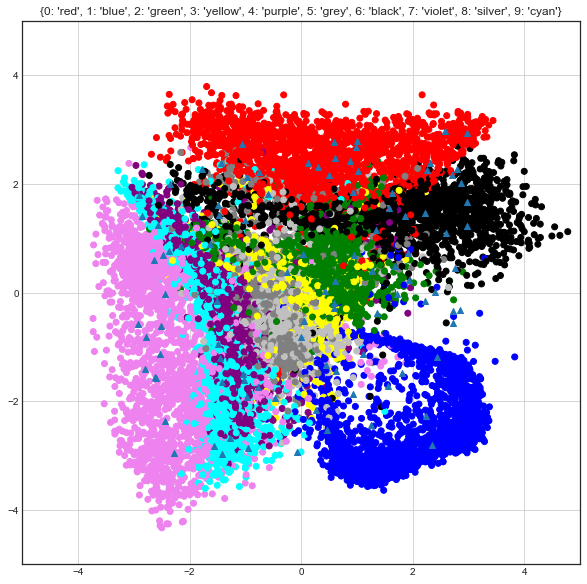

 iter: 27 batch: 19900 range: 4.651978960243207e-06 recon cost: 0.16849747 zero cost: 0.5464455								 one  cost: 0.5749535 fake cost: 1.167715787

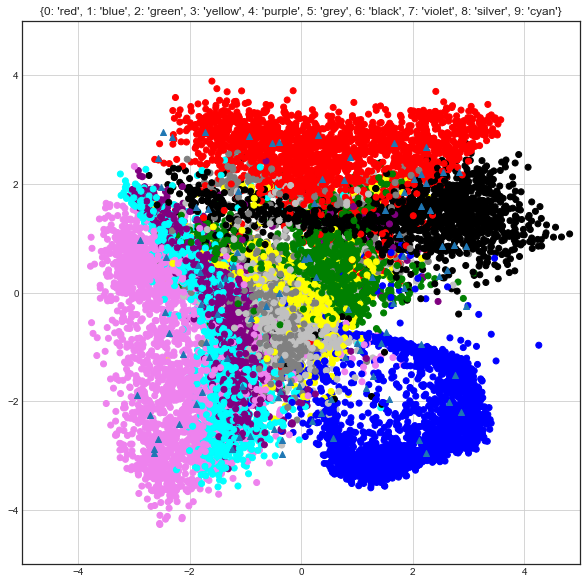

 iter: 28 batch: 19900 range: 4.186781064218887e-06 recon cost: 0.16808407 zero cost: 0.5880615								 one  cost: 0.52145296 fake cost: 1.07341483

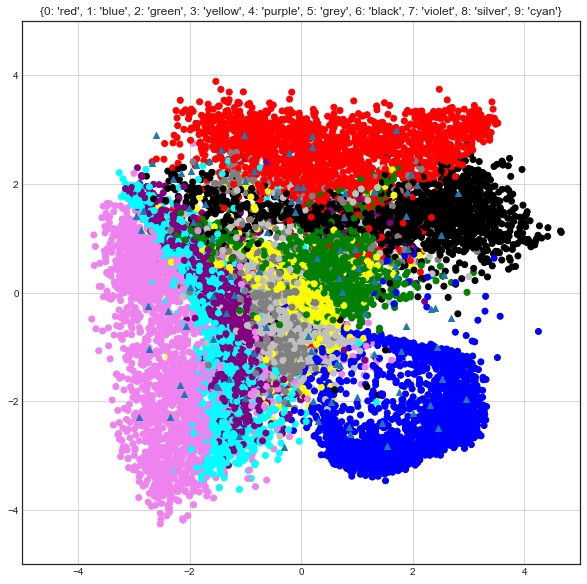

 iter: 29 batch: 19900 range: 3.7681029577969983e-06 recon cost: 0.1674873 zero cost: 0.57814723								 one  cost: 0.53597116 fake cost: 1.069367267

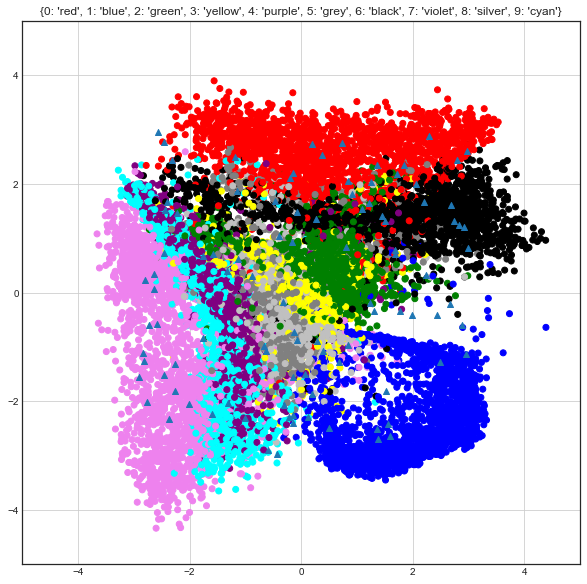

 iter: 30 batch: 19900 range: 3.3912926620172984e-06 recon cost: 0.16699418 zero cost: 0.610335								 one  cost: 0.603974 fake cost: 1.016383665797

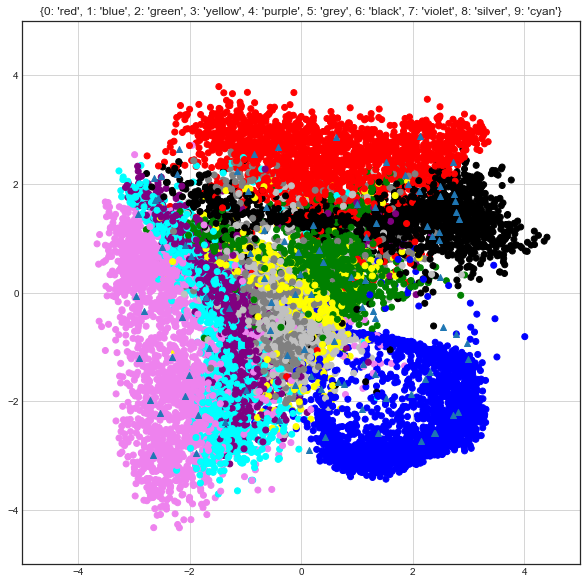

 iter: 31 batch: 19900 range: 3.0521633958155687e-06 recon cost: 0.1664692 zero cost: 0.6053686								 one  cost: 0.54834104 fake cost: 1.0390639365

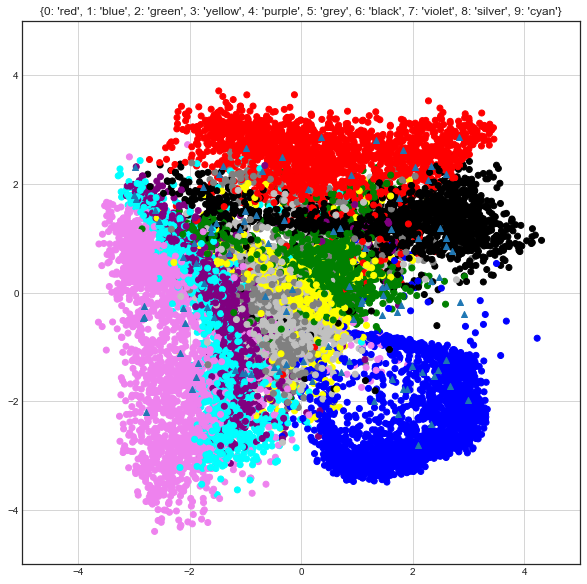

 iter: 32 batch: 19900 range: 2.746947056234012e-06 recon cost: 0.166111 zero cost: 0.609044								 one  cost: 0.6357521 fake cost: 1.0799506385124

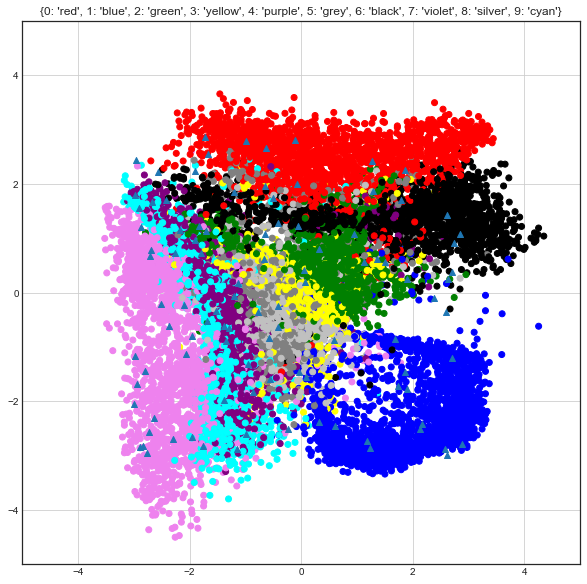

 iter: 33 batch: 19900 range: 2.4722523506106106e-06 recon cost: 0.16570441 zero cost: 0.64651495								 one  cost: 0.6077226 fake cost: 1.00968794

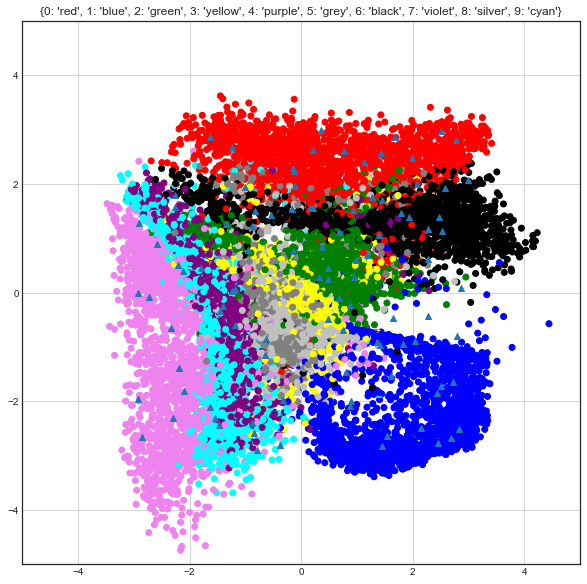

 iter: 34 batch: 19900 range: 2.2250271155495496e-06 recon cost: 0.16530697 zero cost: 0.64266634								 one  cost: 0.6546074 fake cost: 1.025882846

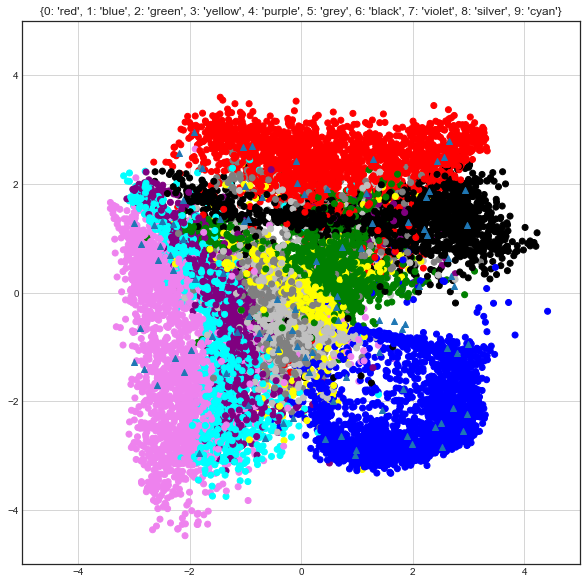

 iter: 35 batch: 19900 range: 2.0025244039945946e-06 recon cost: 0.16531134 zero cost: 0.67704153								 one  cost: 0.59591347 fake cost: 1.01595213

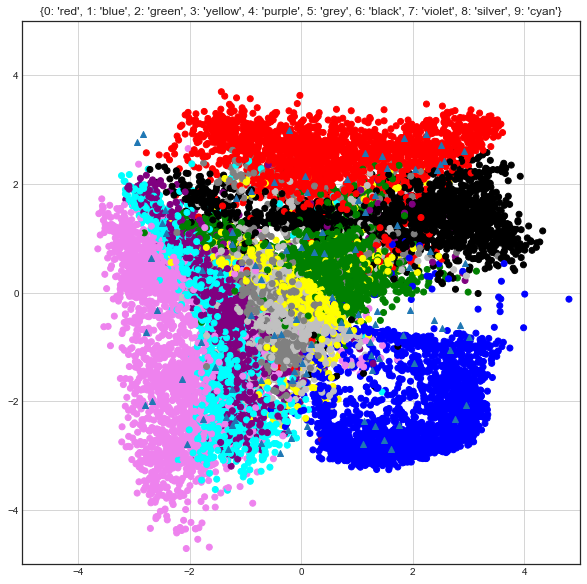

 iter: 36 batch: 19900 range: 1.8022719635951352e-06 recon cost: 0.16520625 zero cost: 0.65424925								 one  cost: 0.59820646 fake cost: 0.9758851

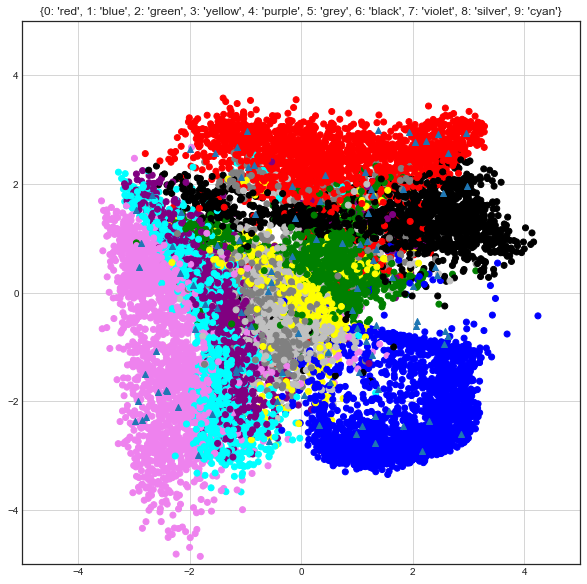

 iter: 37 batch: 19900 range: 1.6220447672356217e-06 recon cost: 0.16447681 zero cost: 0.60988414								 one  cost: 0.57938474 fake cost: 1.13675466

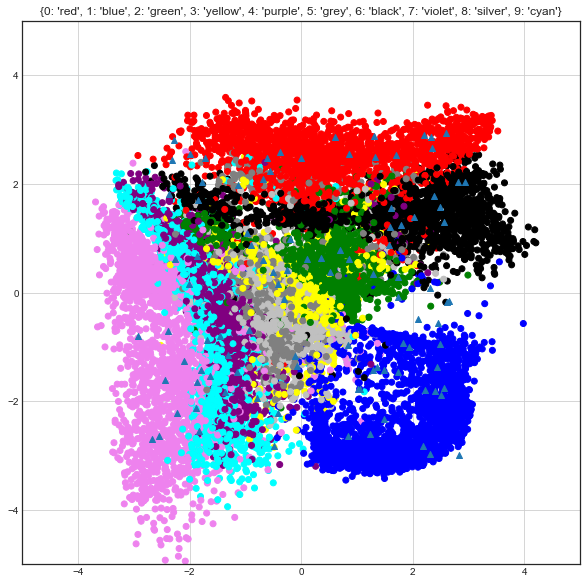

 iter: 38 batch: 19900 range: 1.4598402905120596e-06 recon cost: 0.16451211 zero cost: 0.67972636								 one  cost: 0.5475542 fake cost: 1.007669174

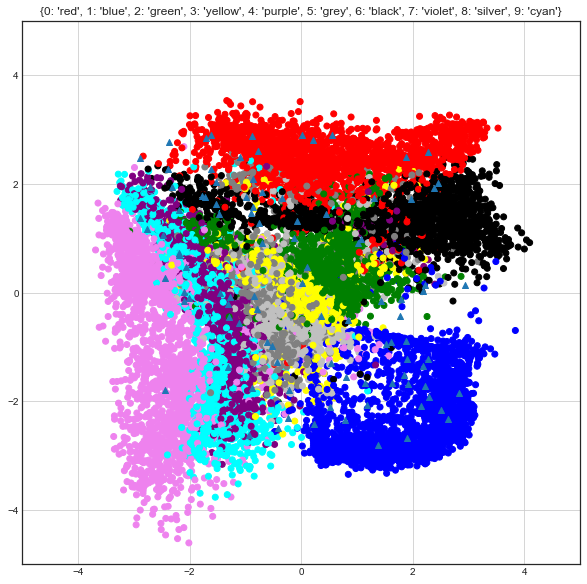

 iter: 39 batch: 19900 range: 1.3138562614608538e-06 recon cost: 0.16399804 zero cost: 0.66742444								 one  cost: 0.6346133 fake cost: 0.961557256

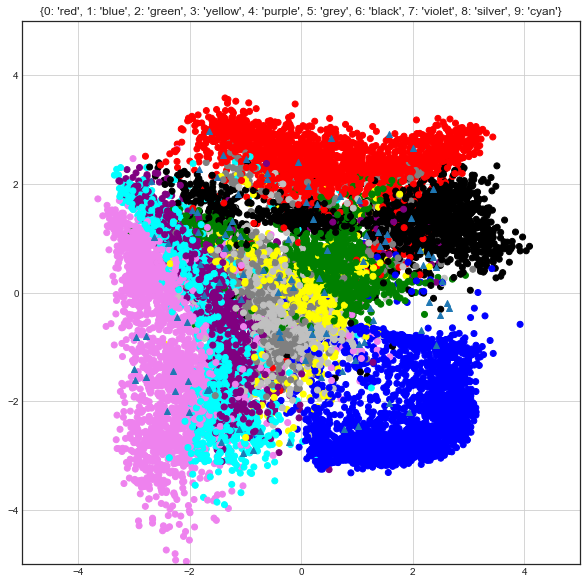

 iter: 40 batch: 19900 range: 1.1824706353147685e-06 recon cost: 0.16390182 zero cost: 0.6855309								 one  cost: 0.60447705 fake cost: 0.907065756

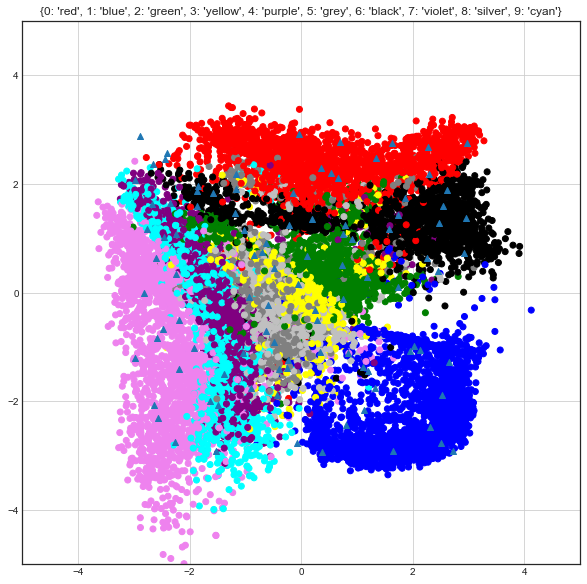

 iter: 41 batch: 19900 range: 1.0642235717832916e-06 recon cost: 0.1638058 zero cost: 0.7307086								 one  cost: 0.54971725 fake cost: 0.8678831717

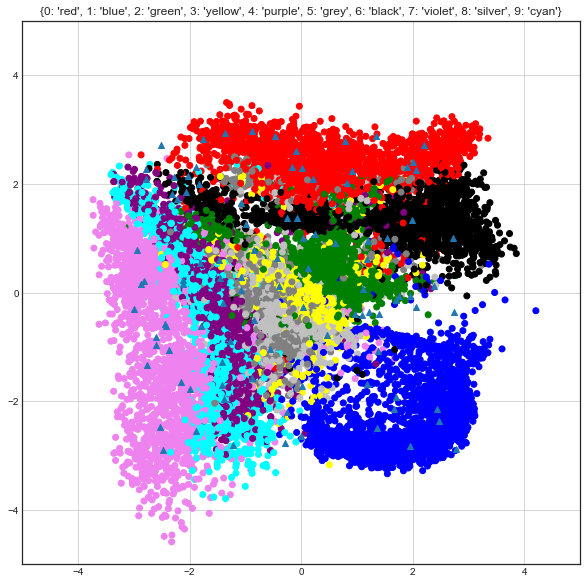

 iter: 42 batch: 19900 range: 9.578012146049625e-07 recon cost: 0.16353373 zero cost: 0.6832866								 one  cost: 0.62969 fake cost: 0.94203332525

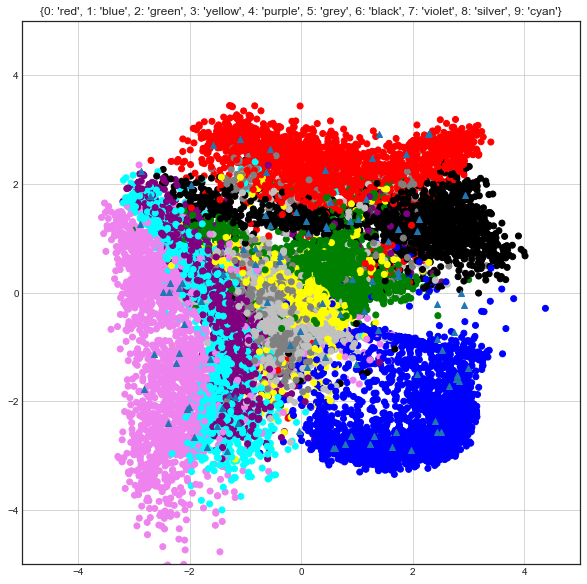

 iter: 43 batch: 19900 range: 8.620210931444663e-07 recon cost: 0.16335712 zero cost: 0.668747								 one  cost: 0.65282613 fake cost: 0.9438305165

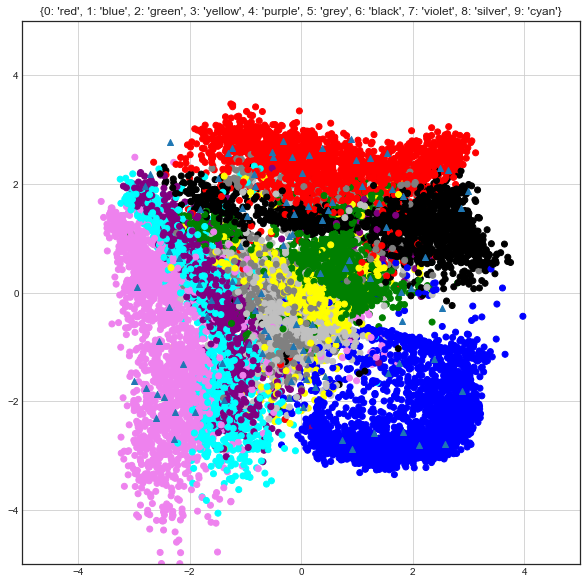

 iter: 44 batch: 19900 range: 7.758189838300196e-07 recon cost: 0.1630839 zero cost: 0.6702813								 one  cost: 0.56793606 fake cost: 0.9489669535

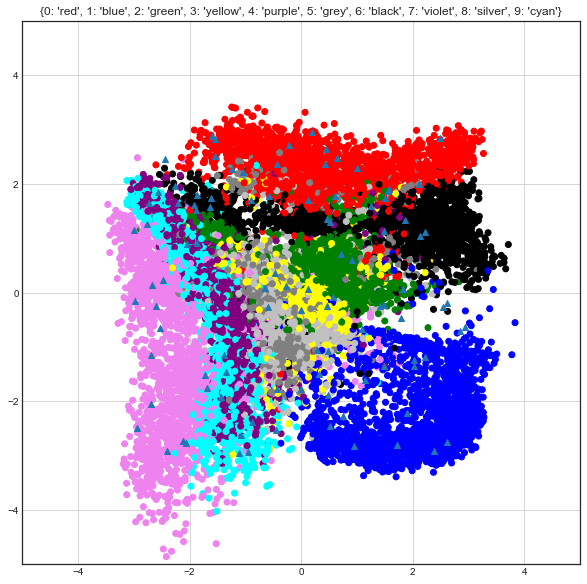

 iter: 45 batch: 19900 range: 6.982370854470177e-07 recon cost: 0.16280383 zero cost: 0.7033541								 one  cost: 0.6630053 fake cost: 0.8935585935

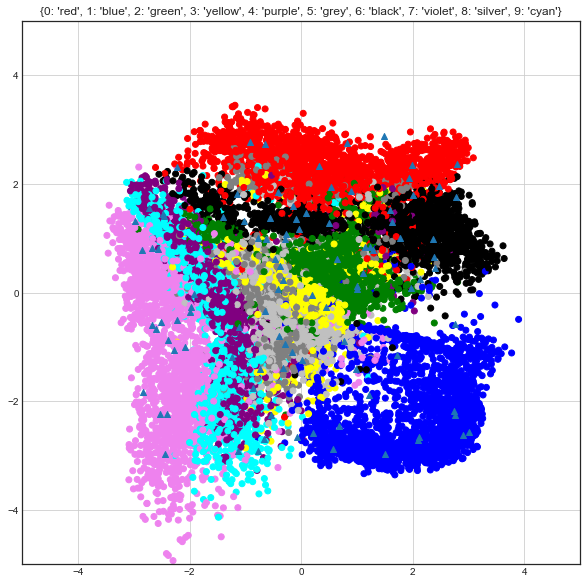

 iter: 46 batch: 19900 range: 6.284133769023159e-07 recon cost: 0.16285458 zero cost: 0.68629843								 one  cost: 0.62251234 fake cost: 0.8953963

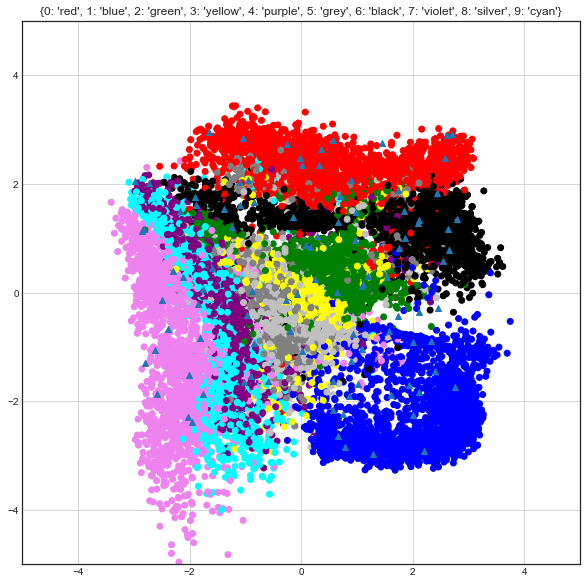

 iter: 47 batch: 19900 range: 5.655720392120844e-07 recon cost: 0.16248675 zero cost: 0.6611132								 one  cost: 0.71208084 fake cost: 0.977314535

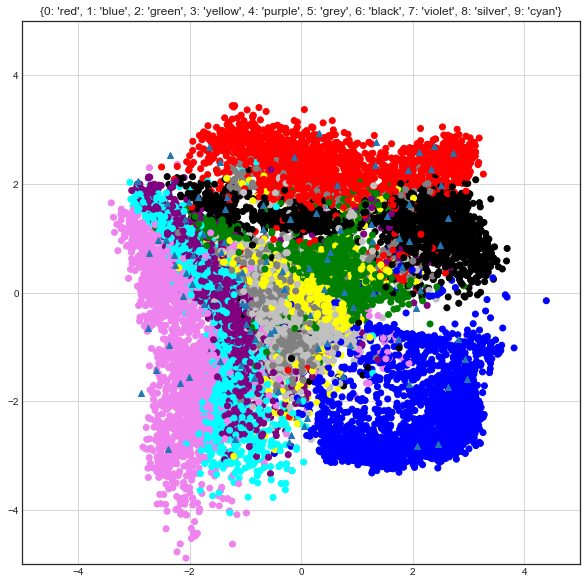

 iter: 48 batch: 19900 range: 5.090148352908759e-07 recon cost: 0.16205293 zero cost: 0.66106504								 one  cost: 0.57619566 fake cost: 0.97670886

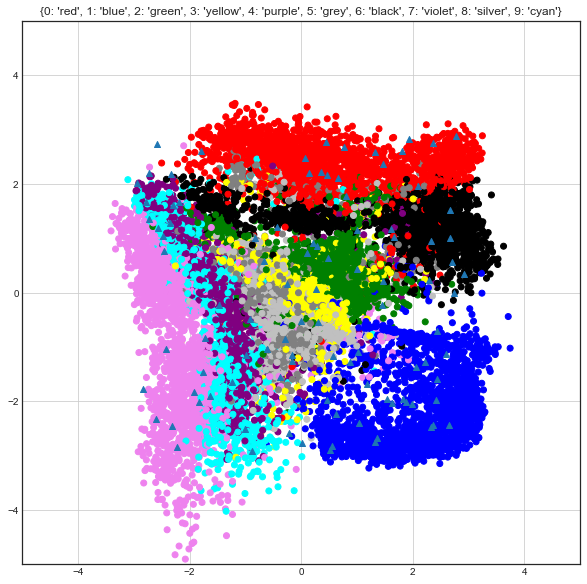

 iter: 49 batch: 19900 range: 4.5811335176178834e-07 recon cost: 0.16185297 zero cost: 0.6938901								 one  cost: 0.5602319 fake cost: 0.9040893566

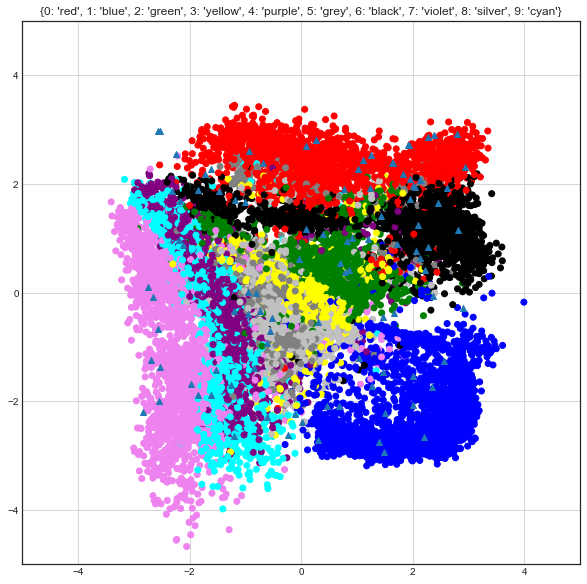

 iter: 50 batch: 19900 range: 4.1230201658560953e-07 recon cost: 0.16203094 zero cost: 0.7107032								 one  cost: 0.50699294 fake cost: 0.939178474

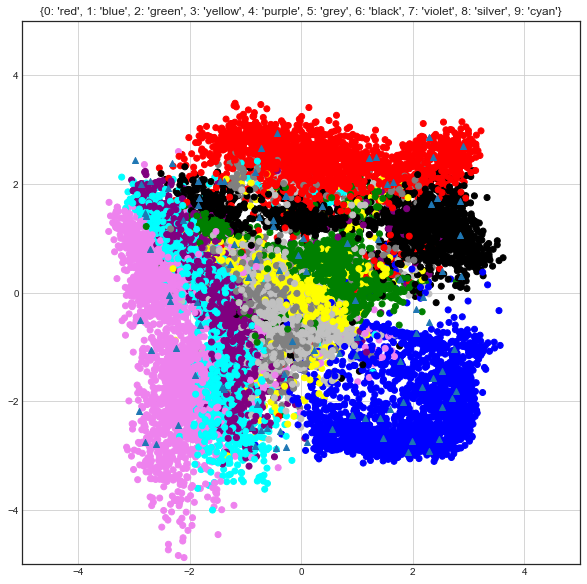

 iter: 51 batch: 19900 range: 3.7107181492704857e-07 recon cost: 0.16239938 zero cost: 0.71429473								 one  cost: 0.6320423 fake cost: 0.88804466

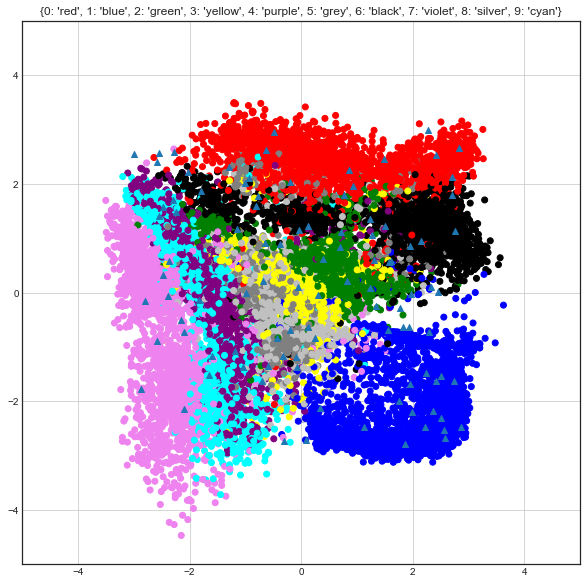

 iter: 52 batch: 19900 range: 3.339646334343437e-07 recon cost: 0.16147248 zero cost: 0.6930783								 one  cost: 0.5841633 fake cost: 0.9905926295

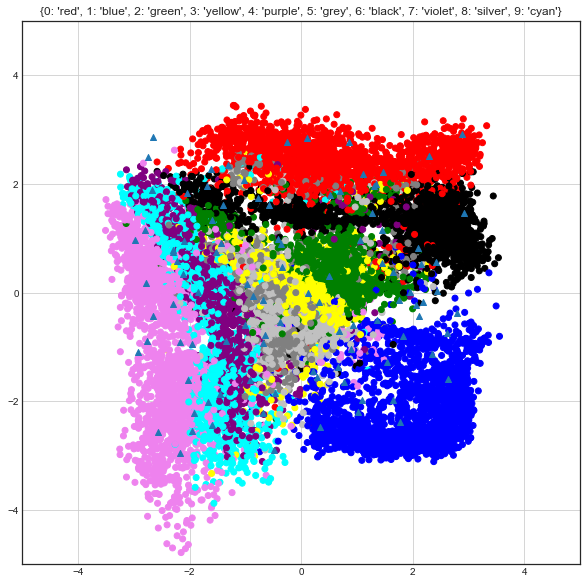

 iter: 53 batch: 19900 range: 3.005681700909093e-07 recon cost: 0.16134138 zero cost: 0.6929271								 one  cost: 0.59830356 fake cost: 0.949873734

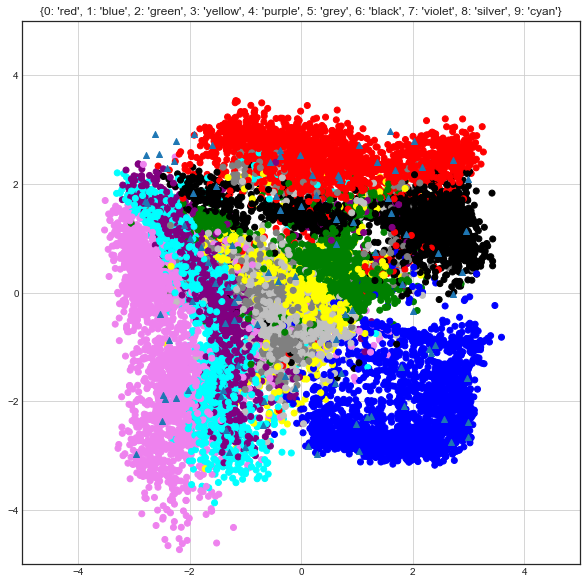

 iter: 54 batch: 19900 range: 2.705113530818184e-07 recon cost: 0.16135277 zero cost: 0.65838873								 one  cost: 0.604916 fake cost: 1.0444155274

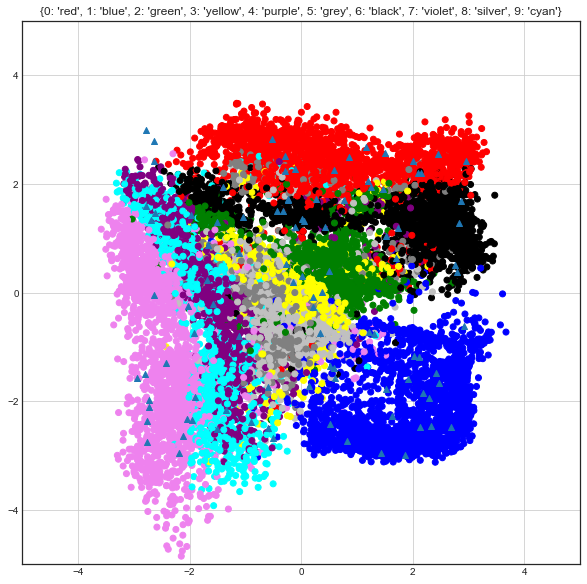

 iter: 55 batch: 19900 range: 2.4346021777363657e-07 recon cost: 0.1611449 zero cost: 0.69010335								 one  cost: 0.57223684 fake cost: 0.93201226

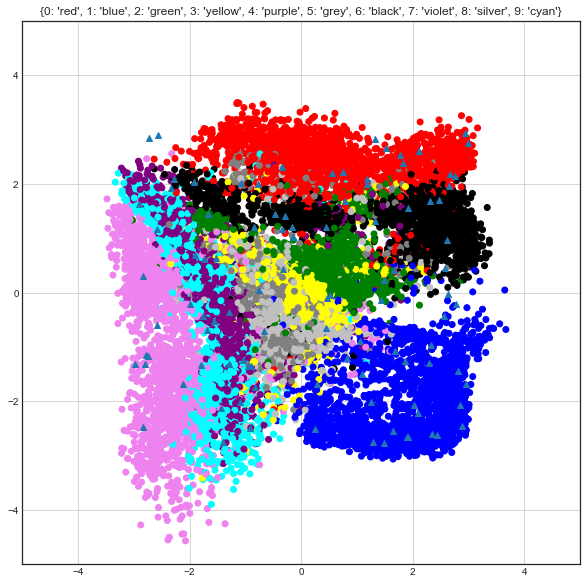

 iter: 56 batch: 19900 range: 2.191141959962729e-07 recon cost: 0.1611505 zero cost: 0.69922185								 one  cost: 0.546236 fake cost: 0.91097146134

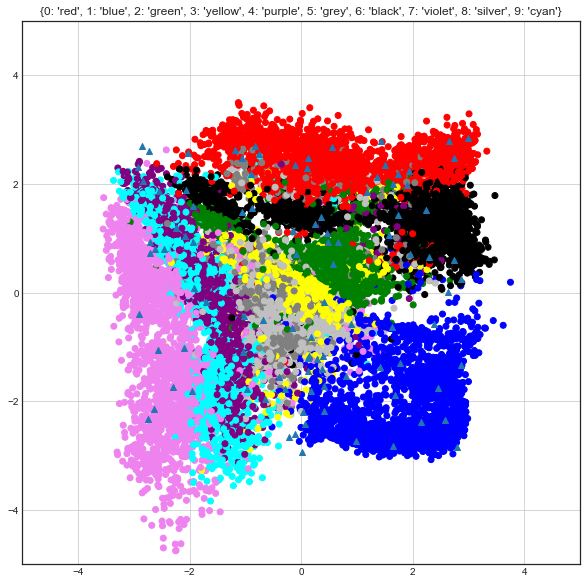

 iter: 57 batch: 19900 range: 1.9720277639664563e-07 recon cost: 0.16108184 zero cost: 0.6612438								 one  cost: 0.5639844 fake cost: 0.9825579895

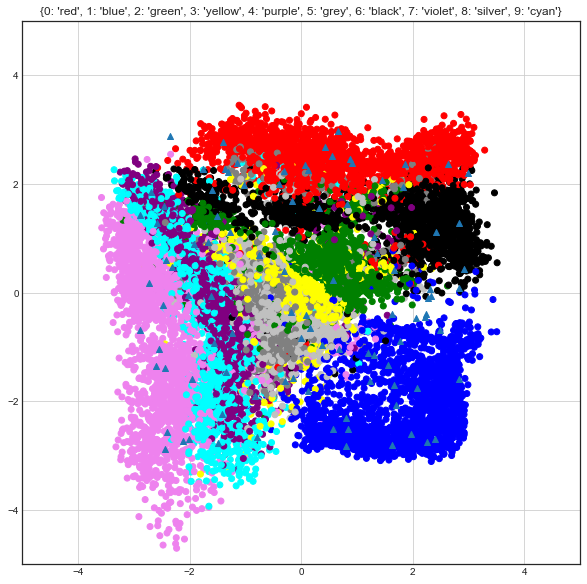

 iter: 58 batch: 19900 range: 1.7748249875698107e-07 recon cost: 0.1607093 zero cost: 0.7169881								 one  cost: 0.55632573 fake cost: 0.9096497667

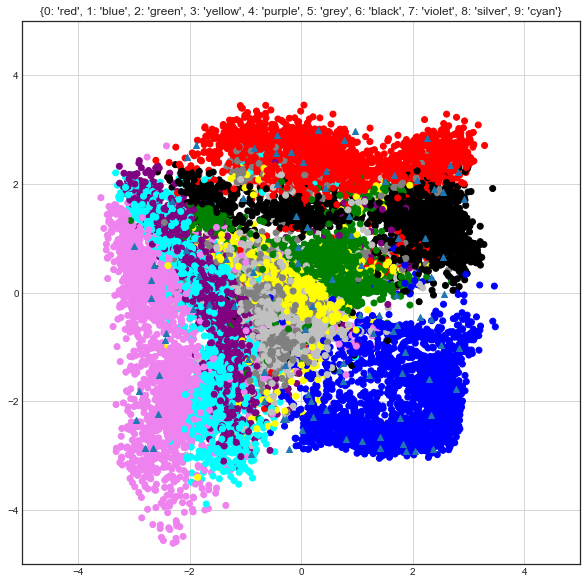

 iter: 59 batch: 19900 range: 1.5973424888128296e-07 recon cost: 0.16042565 zero cost: 0.63650817								 one  cost: 0.6882811 fake cost: 1.02982439

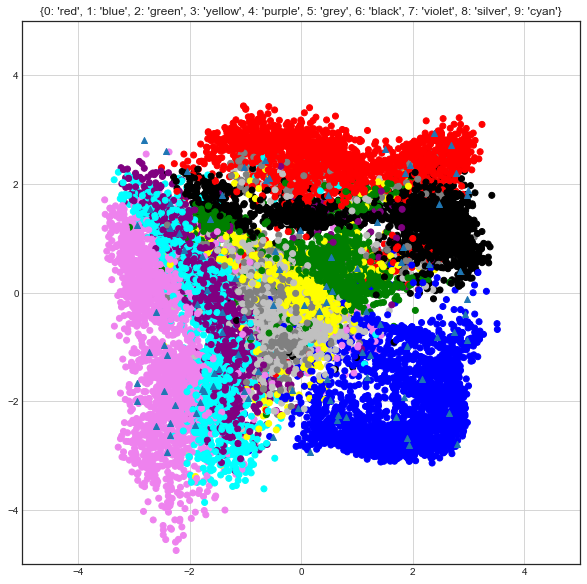

 iter: 60 batch: 19900 range: 1.4376082399315466e-07 recon cost: 0.16019024 zero cost: 0.677609								 one  cost: 0.54877377 fake cost: 0.9700468955

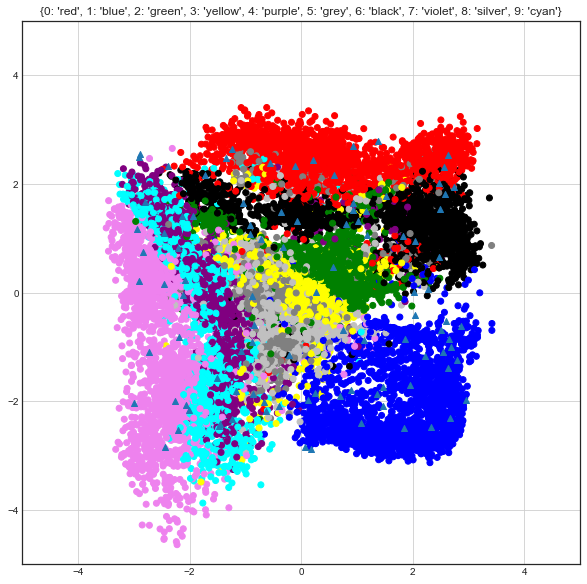

 iter: 61 batch: 19900 range: 1.2938474159383919e-07 recon cost: 0.15997554 zero cost: 0.62109536								 one  cost: 0.66885436 fake cost: 1.02616965

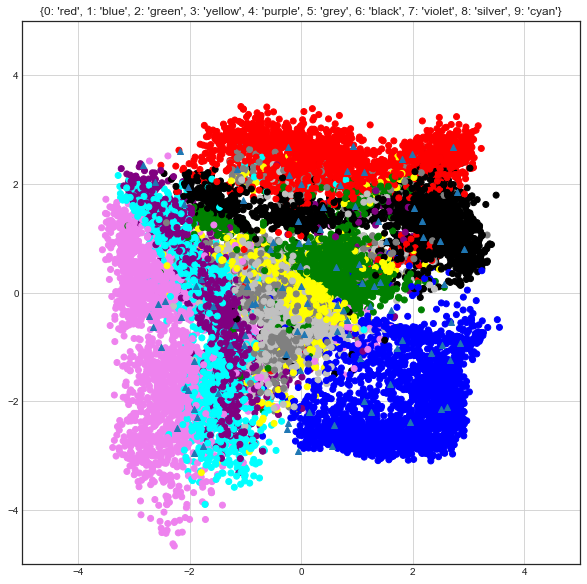

 iter: 62 batch: 19900 range: 1.1644626743445527e-07 recon cost: 0.16014546 zero cost: 0.65181136								 one  cost: 0.64033747 fake cost: 0.94823694

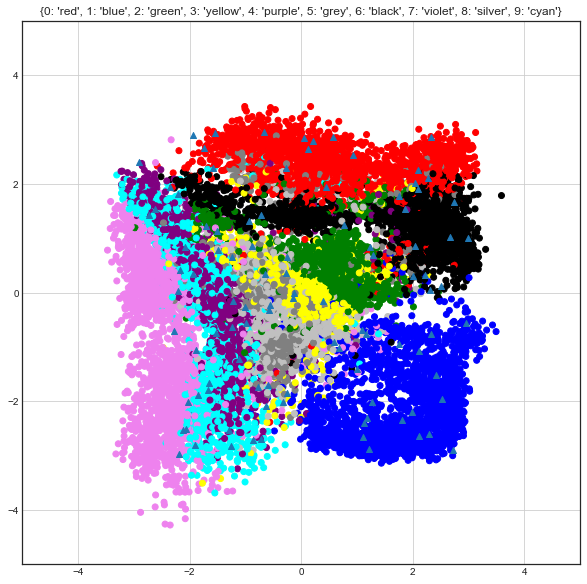

 iter: 63 batch: 19900 range: 1.0480164069100975e-07 recon cost: 0.16015401 zero cost: 0.6356169								 one  cost: 0.6904367 fake cost: 0.981573057

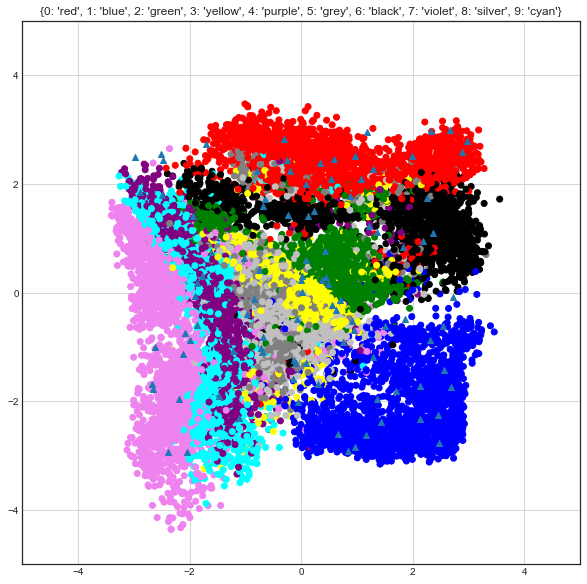

 iter: 64 batch: 19900 range: 9.432147662190878e-08 recon cost: 0.1596374 zero cost: 0.6538214								 one  cost: 0.6282363 fake cost: 0.97558546736

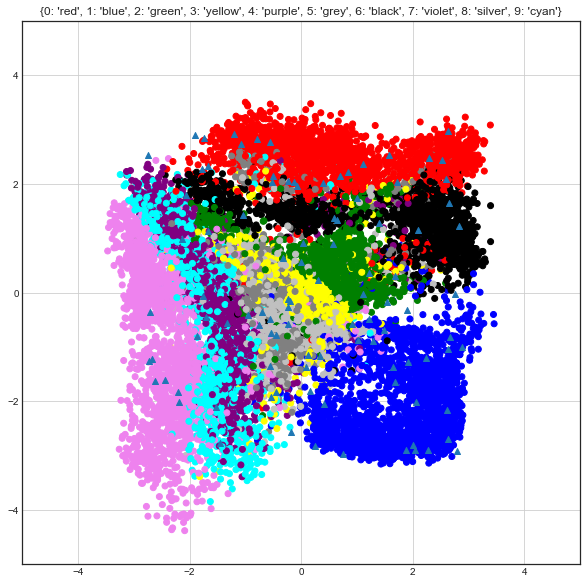

 iter: 65 batch: 19900 range: 8.48893289597179e-08 recon cost: 0.15955608 zero cost: 0.6599383								 one  cost: 0.61712635 fake cost: 0.989975697

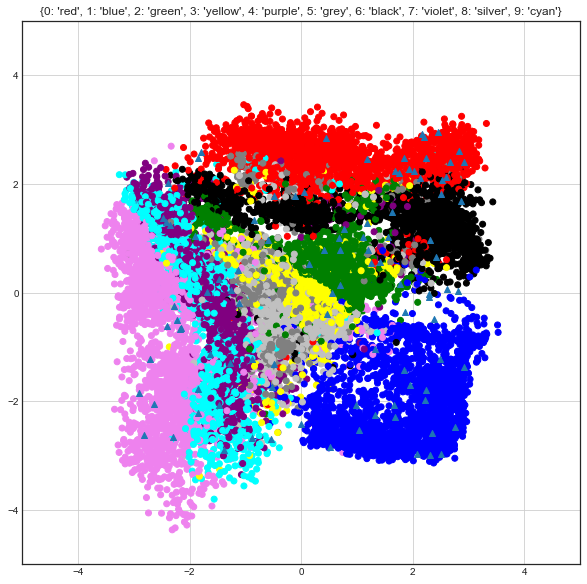

 iter: 66 batch: 19900 range: 7.64003960637461e-08 recon cost: 0.15944232 zero cost: 0.6597336								 one  cost: 0.5383748 fake cost: 0.9959382964

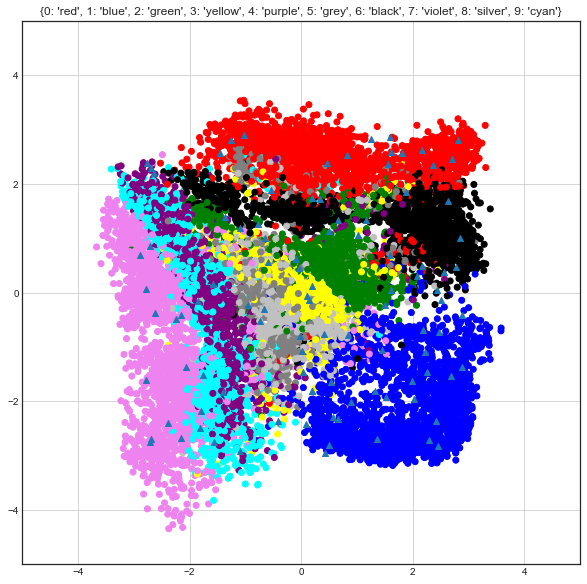

 iter: 67 batch: 19900 range: 6.876035645737149e-08 recon cost: 0.15921621 zero cost: 0.6619653								 one  cost: 0.5231182 fake cost: 0.984190654

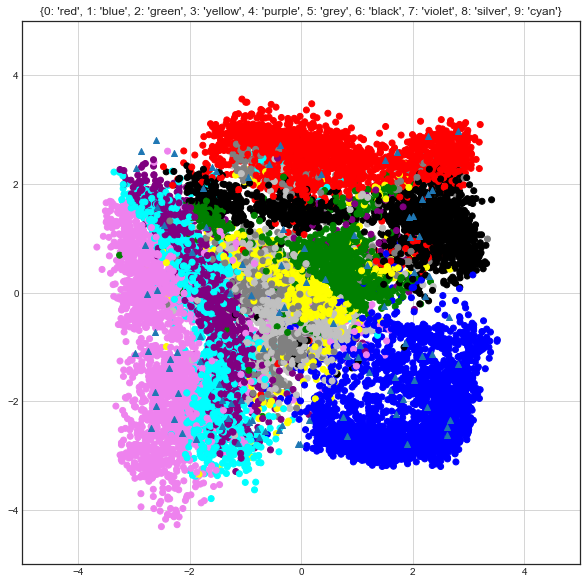

 iter: 68 batch: 19900 range: 6.188432081163434e-08 recon cost: 0.15938538 zero cost: 0.659904								 one  cost: 0.6142689 fake cost: 1.0005660513

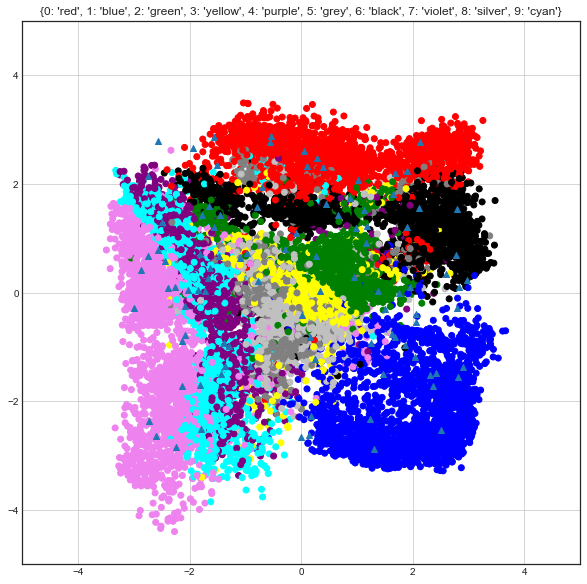

 iter: 69 batch: 19900 range: 5.5695888730470906e-08 recon cost: 0.1591319 zero cost: 0.64511186								 one  cost: 0.6275298 fake cost: 1.0149333573

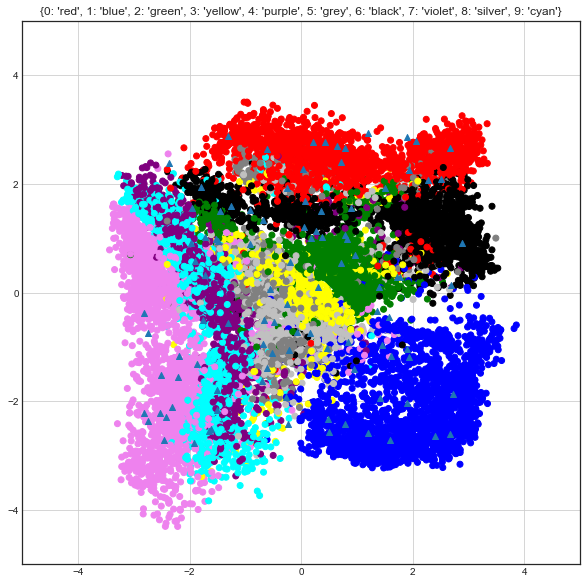

 iter: 70 batch: 19900 range: 5.012629985742382e-08 recon cost: 0.15909663 zero cost: 0.65877855								 one  cost: 0.6380146 fake cost: 0.962631657

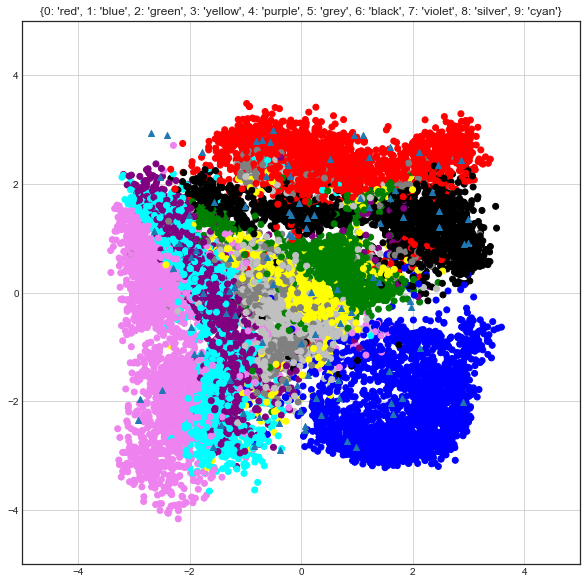

 iter: 71 batch: 19900 range: 4.511366987168144e-08 recon cost: 0.15905969 zero cost: 0.65189135								 one  cost: 0.6154193 fake cost: 0.971876144

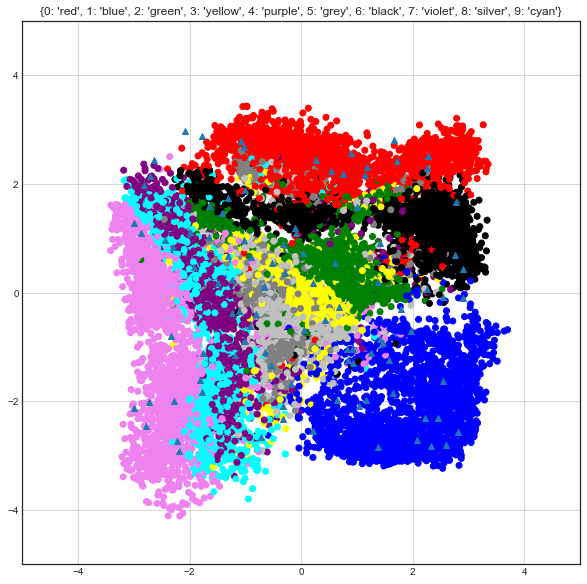

 iter: 72 batch: 19900 range: 4.06023028845133e-08 recon cost: 0.15886164 zero cost: 0.6696922								 one  cost: 0.56781155 fake cost: 0.926271447

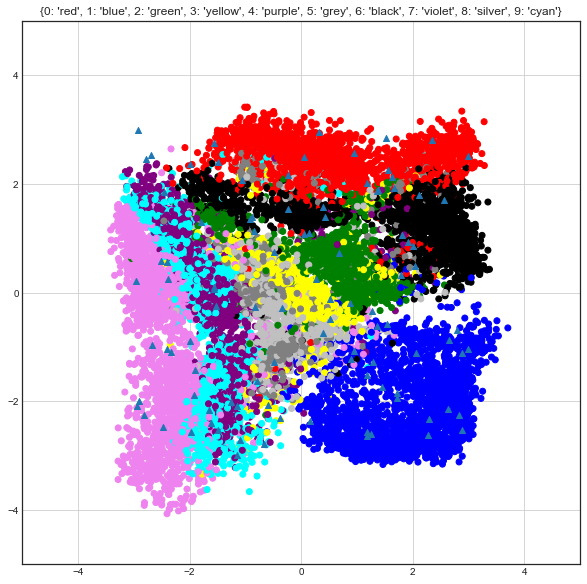

 iter: 73 batch: 19900 range: 3.654207259606197e-08 recon cost: 0.15885498 zero cost: 0.66062194								 one  cost: 0.64468634 fake cost: 0.96866345

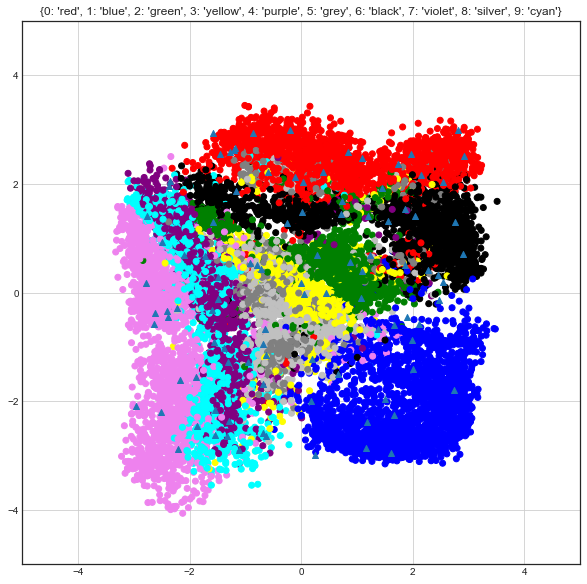

 iter: 74 batch: 19900 range: 3.288786533645577e-08 recon cost: 0.15858176 zero cost: 0.66253257								 one  cost: 0.6427996 fake cost: 0.936444175

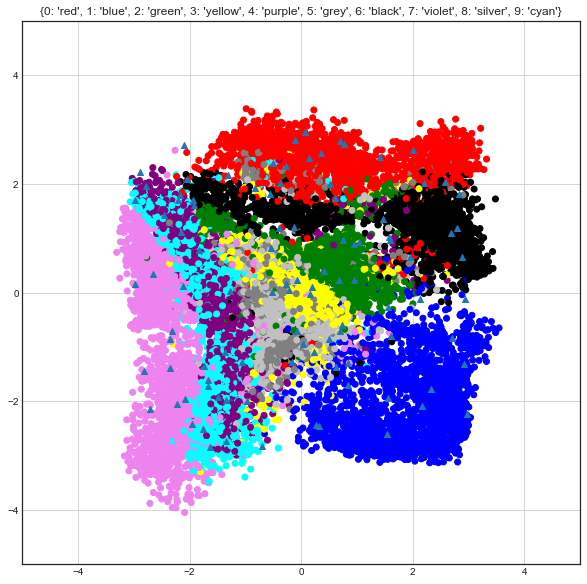

 iter: 75 batch: 19900 range: 2.9599078802810195e-08 recon cost: 0.15843663 zero cost: 0.6415301								 one  cost: 0.6234341 fake cost: 0.9615811863

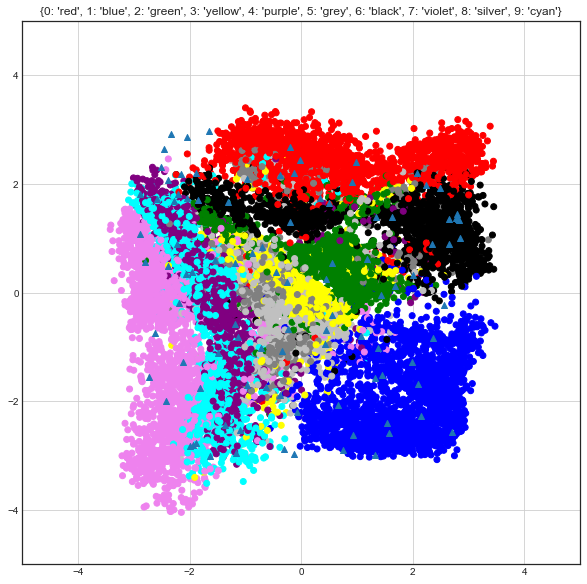

 iter: 76 batch: 19900 range: 2.6639170922529175e-08 recon cost: 0.15868291 zero cost: 0.6711496								 one  cost: 0.5987117 fake cost: 0.9621855375

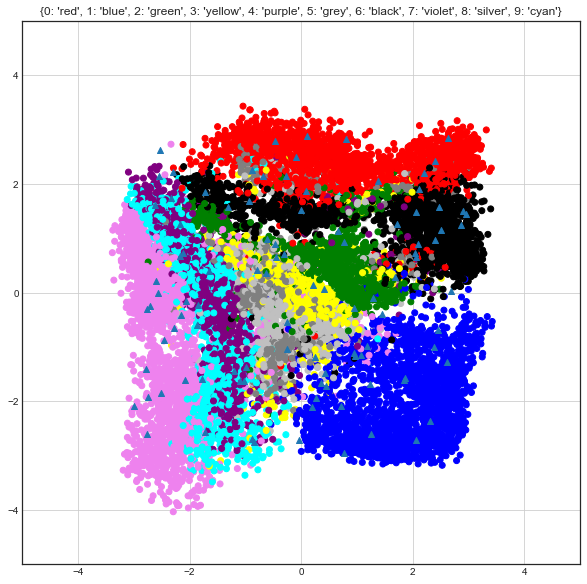

 iter: 77 batch: 19900 range: 2.397525383027626e-08 recon cost: 0.15870301 zero cost: 0.6807727								 one  cost: 0.65496826 fake cost: 0.938137357

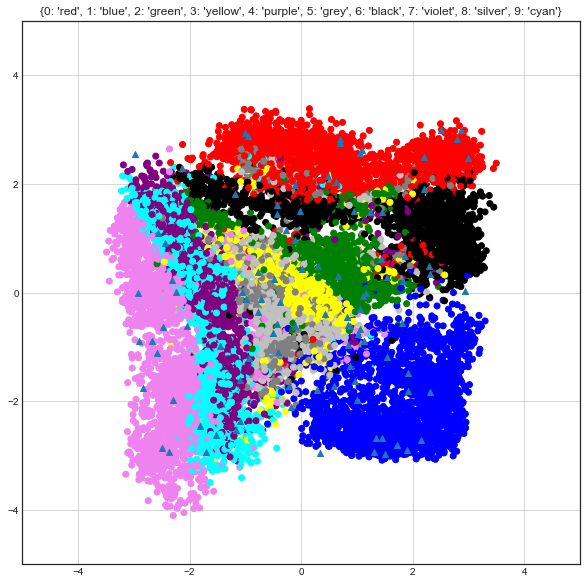

 iter: 78 batch: 19900 range: 2.1577728447248635e-08 recon cost: 0.15892065 zero cost: 0.65982926								 one  cost: 0.58859736 fake cost: 0.95729085

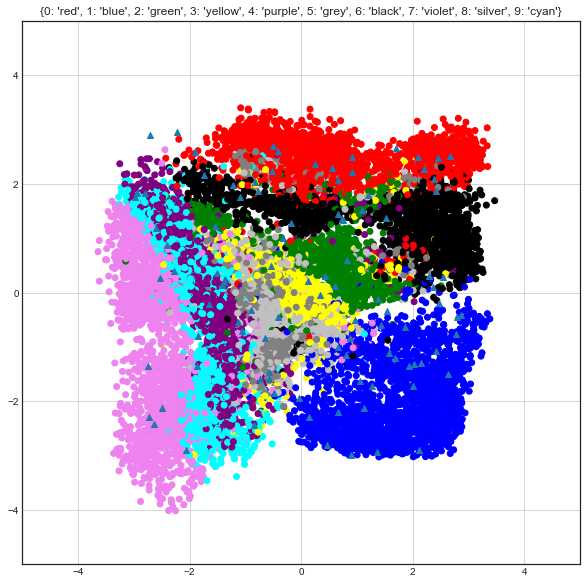

 iter: 79 batch: 19900 range: 1.941995560252377e-08 recon cost: 0.15858404 zero cost: 0.7143945								 one  cost: 0.5976369 fake cost: 0.8690967696

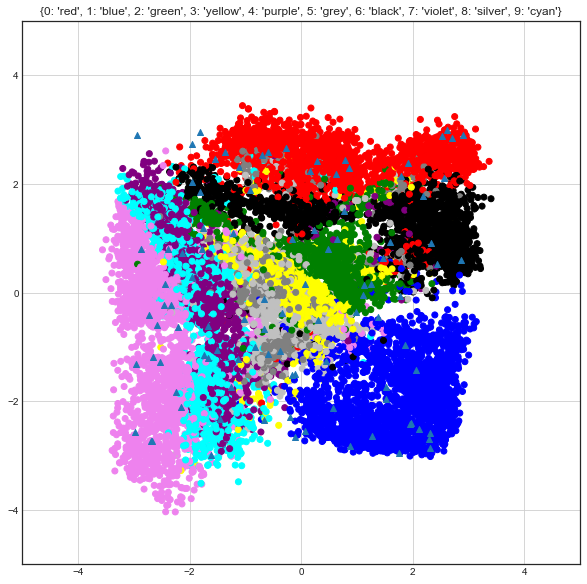

 iter: 80 batch: 19900 range: 1.7477960042271394e-08 recon cost: 0.15835635 zero cost: 0.67834747								 one  cost: 0.6312097 fake cost: 0.910582394

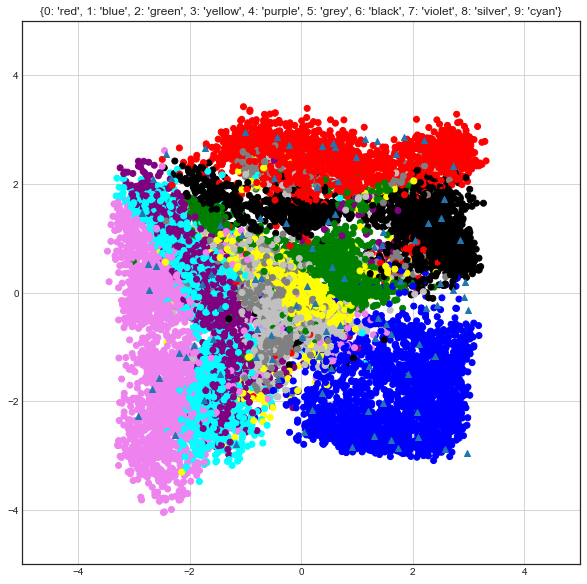

 iter: 81 batch: 19900 range: 1.5730164038044255e-08 recon cost: 0.15839346 zero cost: 0.6684178								 one  cost: 0.55392104 fake cost: 0.895085756

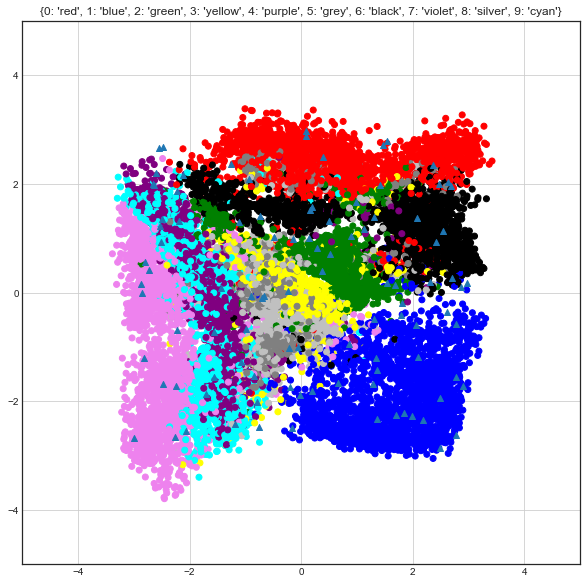

 iter: 82 batch: 19900 range: 1.415714763423983e-08 recon cost: 0.15875514 zero cost: 0.6991303								 one  cost: 0.5317904 fake cost: 0.8774484467

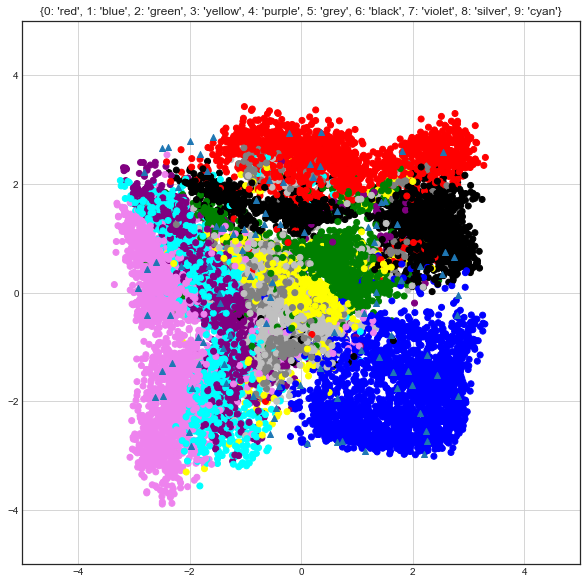

 iter: 83 batch: 19900 range: 1.2741432870815846e-08 recon cost: 0.15817128 zero cost: 0.6525671								 one  cost: 0.59031445 fake cost: 0.931689633

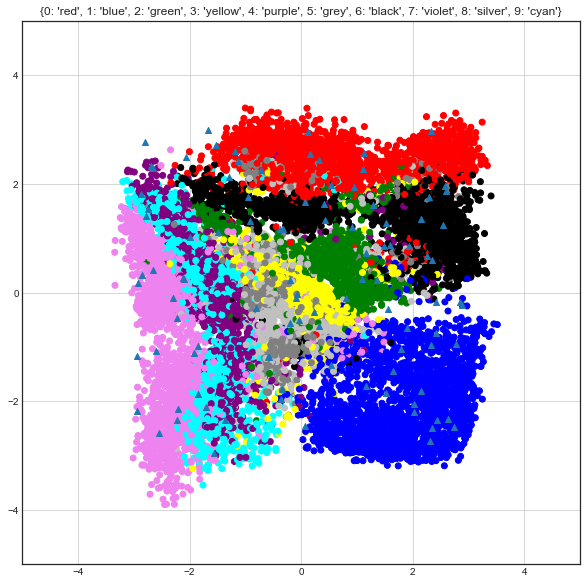

 iter: 84 batch: 19900 range: 1.1467289583734262e-08 recon cost: 0.15790284 zero cost: 0.6625105								 one  cost: 0.5745765 fake cost: 0.9705011845

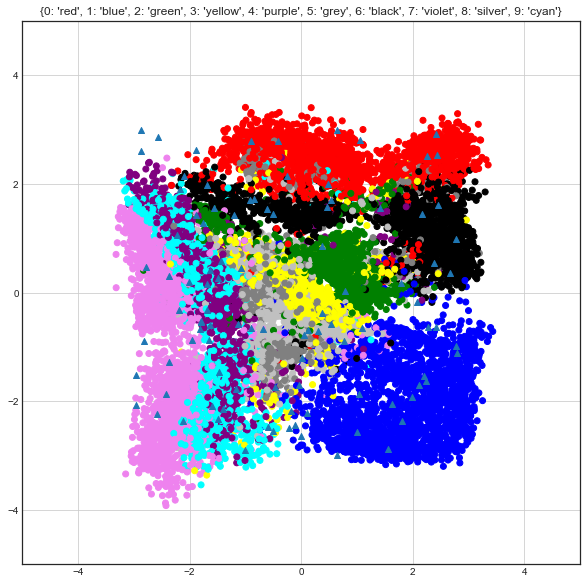

 iter: 85 batch: 19900 range: 1.0320560625360836e-08 recon cost: 0.1578012 zero cost: 0.66353106								 one  cost: 0.6141348 fake cost: 0.9592328426

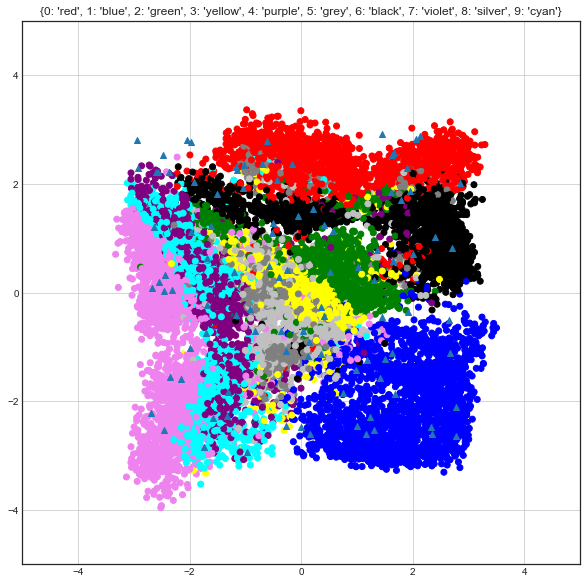

 iter: 86 batch: 19900 range: 9.288504562824752e-09 recon cost: 0.15756154 zero cost: 0.6457641								 one  cost: 0.67983824 fake cost: 1.040471793

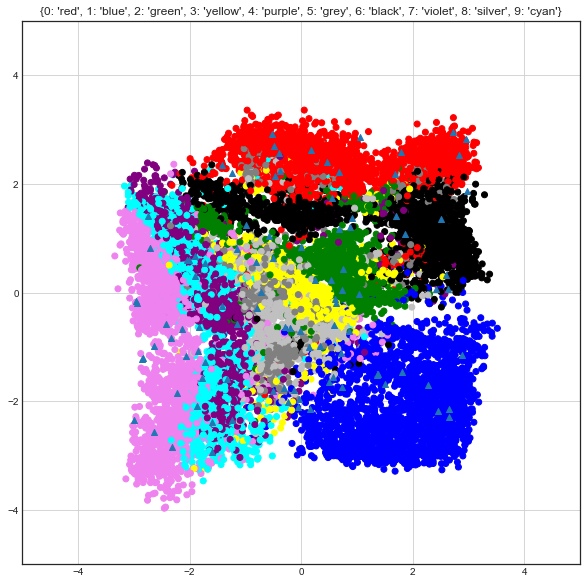

 iter: 87 batch: 19900 range: 8.359654106542276e-09 recon cost: 0.15736772 zero cost: 0.650162								 one  cost: 0.65220094 fake cost: 0.9925624346

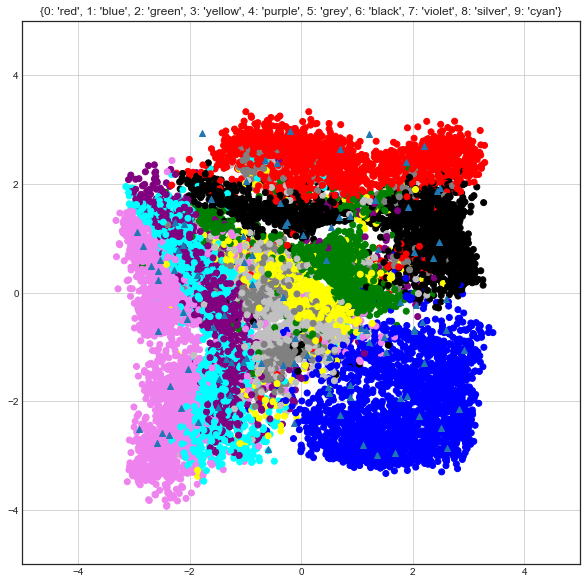

 iter: 88 batch: 19900 range: 7.523688695888049e-09 recon cost: 0.1574229 zero cost: 0.6794183								 one  cost: 0.56164396 fake cost: 0.9486907144

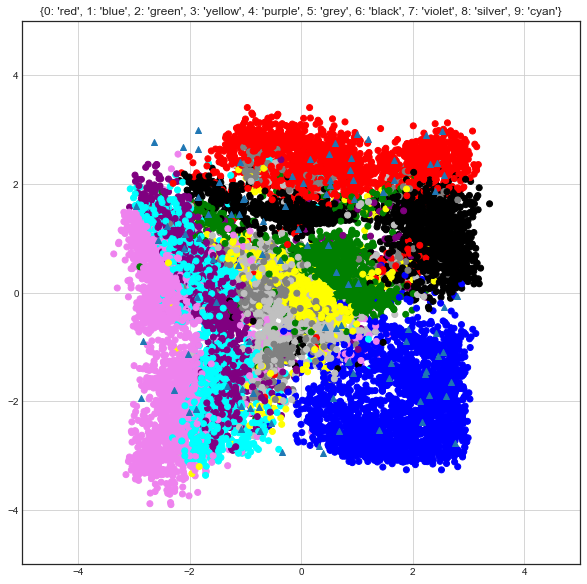

 iter: 89 batch: 19900 range: 6.771319826299244e-09 recon cost: 0.15716709 zero cost: 0.65105736								 one  cost: 0.62483615 fake cost: 0.96973584

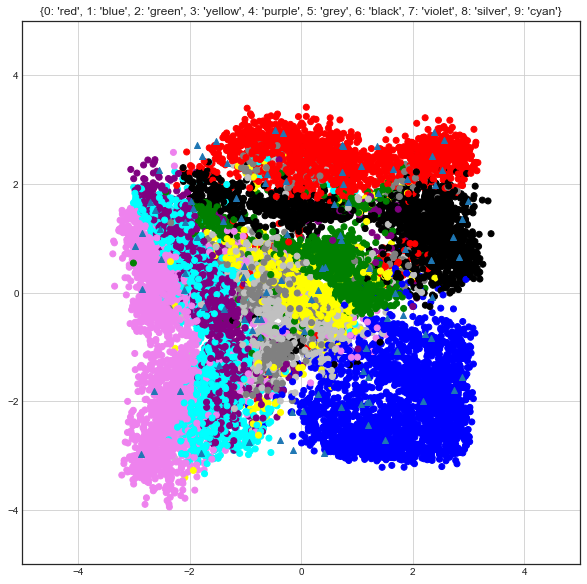

 iter: 90 batch: 19900 range: 6.09418784366932e-09 recon cost: 0.15741134 zero cost: 0.6632368								 one  cost: 0.64408326 fake cost: 0.969411557

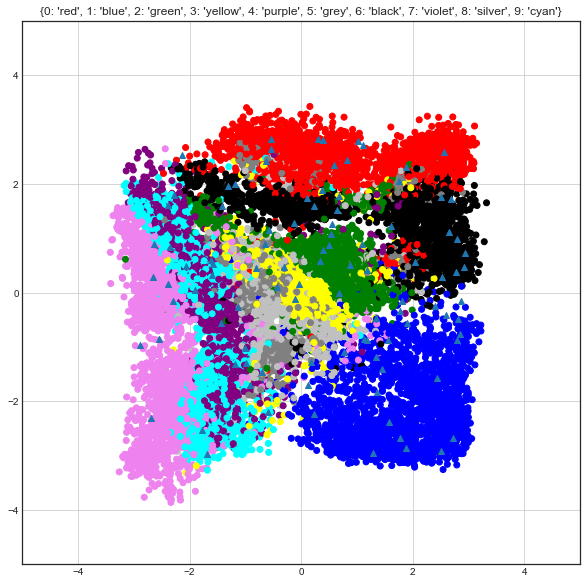

 iter: 91 batch: 19900 range: 5.484769059302388e-09 recon cost: 0.1571033 zero cost: 0.6571028								 one  cost: 0.5607563 fake cost: 0.95901245795

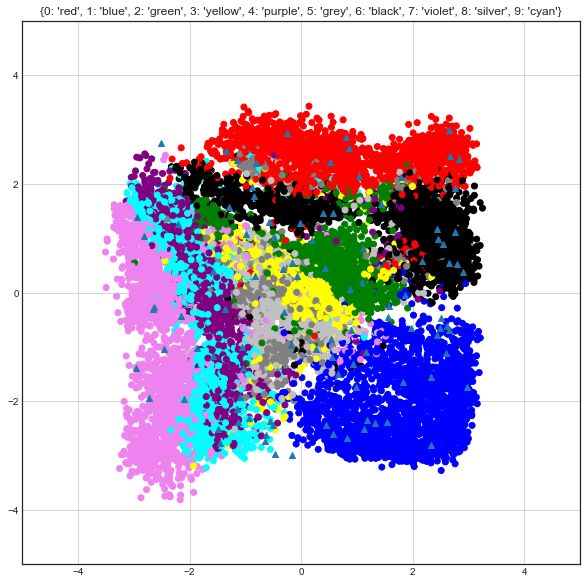

 iter: 92 batch: 19900 range: 4.936292153372149e-09 recon cost: 0.1568905 zero cost: 0.64657974								 one  cost: 0.65887094 fake cost: 0.981476553

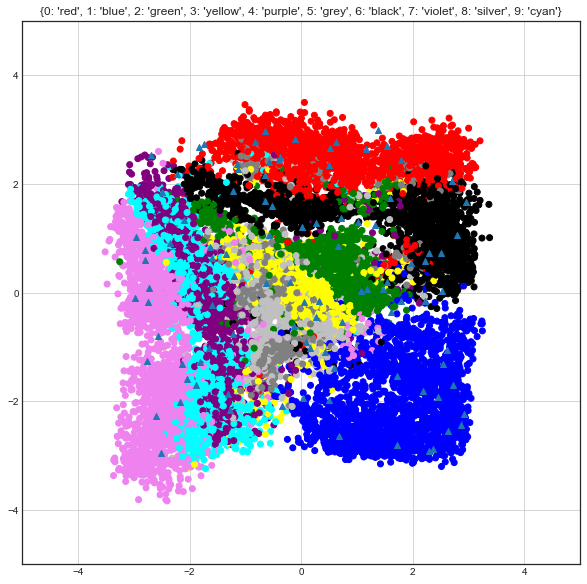

 iter: 93 batch: 19900 range: 4.442662938034934e-09 recon cost: 0.15672296 zero cost: 0.65374285								 one  cost: 0.61328894 fake cost: 0.98681456

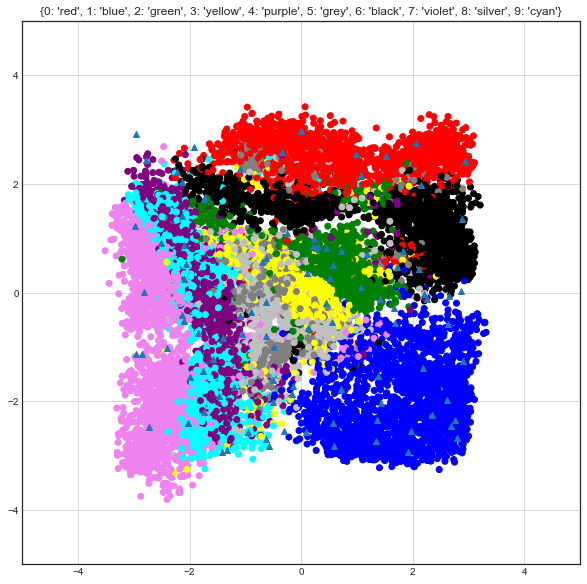

 iter: 94 batch: 19900 range: 3.9983966442314404e-09 recon cost: 0.15669923 zero cost: 0.66161036								 one  cost: 0.52489287 fake cost: 0.91875896

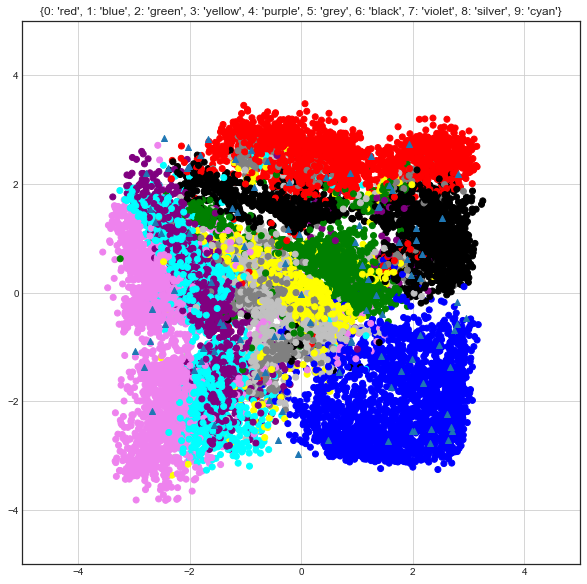

 iter: 95 batch: 19900 range: 3.5985569798082966e-09 recon cost: 0.15738982 zero cost: 0.6456675								 one  cost: 0.6072364 fake cost: 0.9580171165

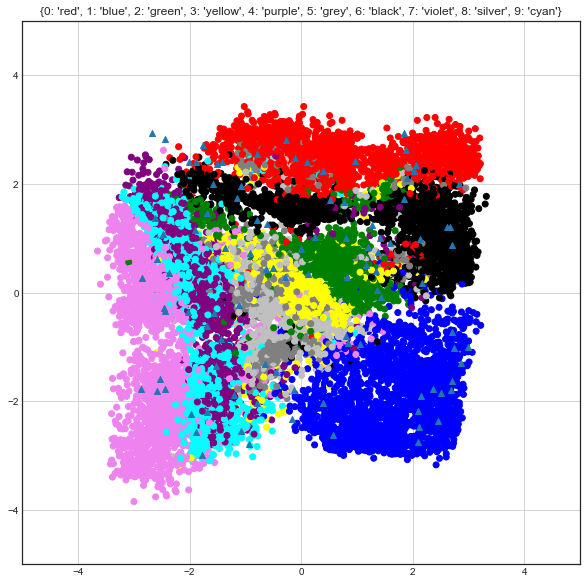

 iter: 96 batch: 19900 range: 3.238701281827467e-09 recon cost: 0.15713698 zero cost: 0.6566577								 one  cost: 0.62635773 fake cost: 0.911194154

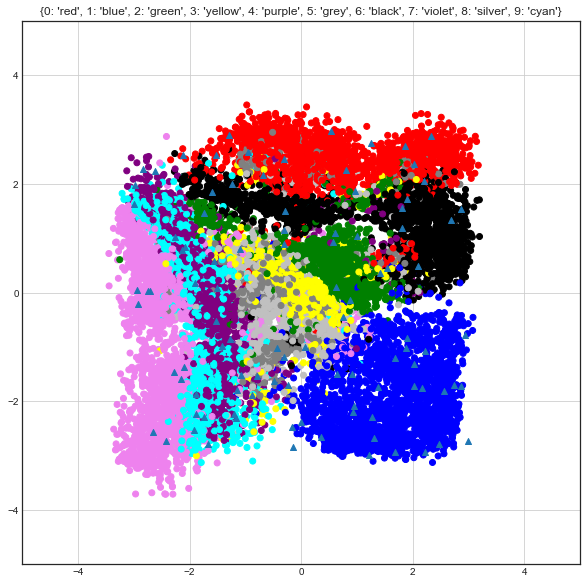

 iter: 97 batch: 19900 range: 2.9148311536447202e-09 recon cost: 0.15680598 zero cost: 0.6594291								 one  cost: 0.5713297 fake cost: 0.9286199523

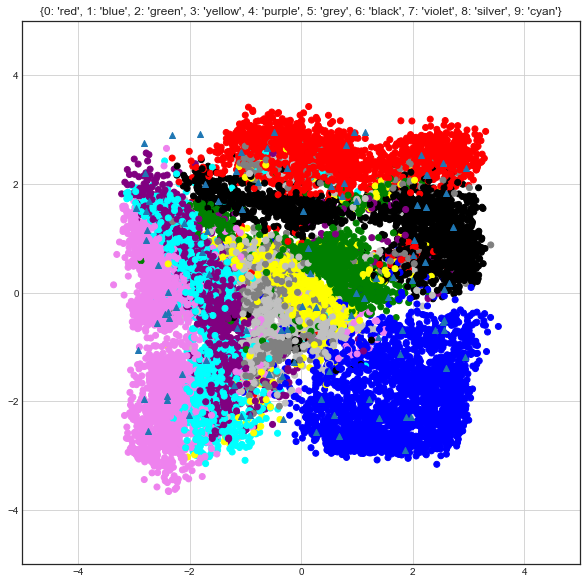

 iter: 98 batch: 19900 range: 2.623348038280248e-09 recon cost: 0.15661626 zero cost: 0.62779343								 one  cost: 0.67001945 fake cost: 0.95609455

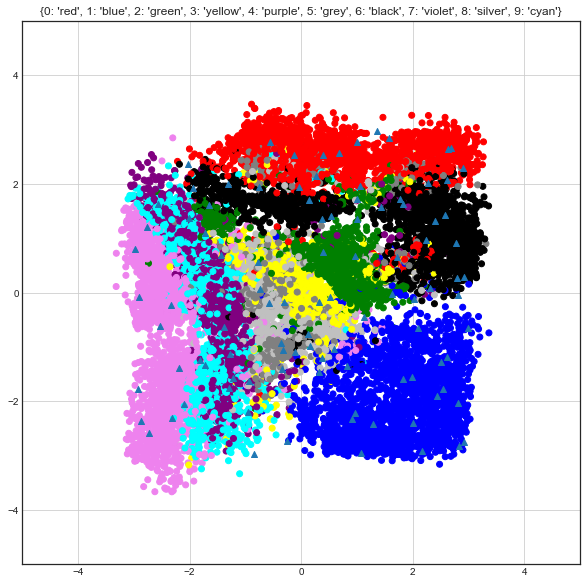

 iter: 99 batch: 19900 range: 2.361013234452223e-09 recon cost: 0.15642594 zero cost: 0.67085195								 one  cost: 0.6362144 fake cost: 0.894621733

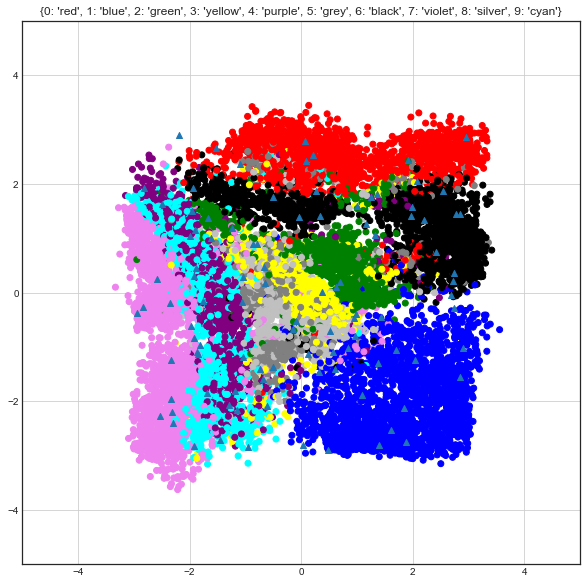

 iter: 100 batch: 19900 range: 2.124911911007001e-09 recon cost: 0.15595487 zero cost: 0.6436279								 one  cost: 0.543544 fake cost: 0.93141092363

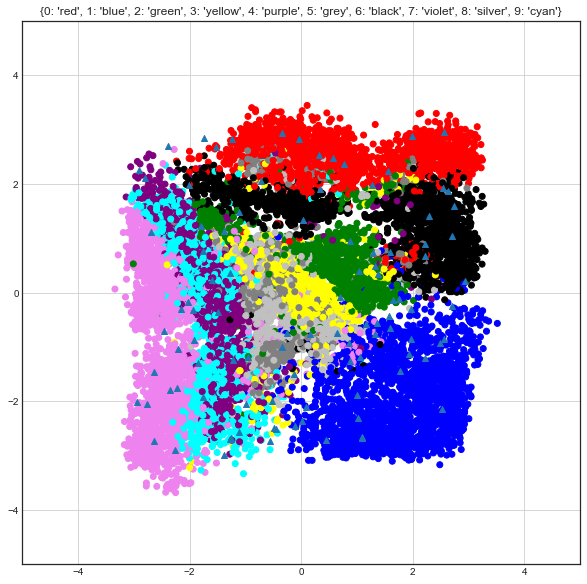

In [23]:
# start the session
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}

#                     00005
aimed_range_start = 0.00008
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z      = np.random.uniform(low=-3.0, high=3.0,size=(batch_size, 2)).astype(np.float32)
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.0002,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.002,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.9    
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
        plt.xlim(-5,5);plt.ylim(-5,5);
        plt.grid();plt.show()

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()